# Forecasting deposit stickyness in custodian banking institutions  

## Project Description: 
I currently work for a large custody bank that as most other organizations are dealing with uncertainty driven by the Covid -19 epidemic.  Unlike many other retail-oriented services we experience deposit growth during periods of stress.  The question that arises in all of our executive team meetings is if the deposits will stay on, and if not how long will the duration of elevated deposits be. The importance to my field of work is determining how will those coming deposit actions of our clients will influence the liquidity position of the bank, and how we need to manage preemptively for those impending actions. This project leveraging historical balance sheet information available from custodian banking institutions, will forecast ramp up and ramp down inflection points for deposit growth and subsequent decline using various macroeconomic indicators as independent variables in an effort to get a sense of what’s to come for our bank's deposit behavior. 

## Data Science Task: 
To determine and apply the most appropriate supervised learning algorithm to forecast deposit inflection points during economic stress, in an effort to forecast current deposit trends at my banking institution

## Data:  
This project will take historical balance sheet information, specifically foreign office, retail, and commercial deposits from some of the large custody banks including Northern Trust, Bank of New York, and State Street Bank & Trust using publicly available balance sheet information from SNL or via the Edgar API tool, and then obtain historical macroeconomic indicators from FRED, including interest rates, stock indices like Dow Jones S&P, GDP Growth, CPI, VIX unemployment and treasury yield in an effort to forecast the inflection point in deposit growth and subsequent declines resulting from periods of economic stress. 
For this effort I will be looking at quarterly banking deposit data as my dependent variable, I’m going to try and go back as far as possible with historical data hoping to capture at the least the 1987 black Monday related recession, this data will be obtained via S&P’s SNL and or the EDGAR API [2].  For my independent variables I plan to leveraging FRED pretty heavily to obtain the most up to date historical macroeconomic indicator information, and may grab data via the FRED API [3]. 
In terms of data size, while there will be many variables to start with, this will be unlike a twitter stream project that will collect immense amounts of information, this project is finite and can potentially only go back to the 1980’s so data size and processing time due to quantity is not of concern.  

## Data Analysis:
I plan to take Jason Brownlee’s approach of spot-checking various supervised learning algorithms including potentially regression, support vector machines, random forest, LDA, naïve Bayes, decision tree, KNN and ANN to determine the best fit to predict deposit inflection points [1]. I obviously have many macro-economic indicators and will do a clean up to find the most impactful indicators to explain and forecast deposit movement, in an effort to understand indicators that impact this behavior the most, and use that to predict future deposit behavior

## First steps - Independent Data Step: 
We will obtain all the necesary data for our independent variables, whose sources are largely FRED and Yahoo Finance for the Dow Jones and S&P 500 data [6][7]

In [389]:
#import packages
import pandas as pd
from datetime import datetime
import datetime
import numpy as np
import csv
import os 
import time
import re

In [390]:
#Vix 
vix = pd.read_csv('VIXCLS.csv',
                  sep=r',',
                  skipinitialspace = True, 
                 converters = {'DATE':pd.to_datetime,
                              'VIXCLS': np.float()})
vix

,DATE,VIXCLS
0,1990-01-02,17.24
1,1990-01-03,18.19
2,1990-01-04,19.22
3,1990-01-05,20.11
4,1990-01-08,20.26
...,...,...
8038,2020-10-23,27.55
8039,2020-10-26,32.46
8040,2020-10-27,33.35
8041,2020-10-28,40.28


In [391]:
#Fed Funds Rate
ff = pd.read_csv('FEDFUNDS (1).csv',
                sep =r',', 
                skipinitialspace = True, 
                converters = {'DATE': pd.to_datetime,
                             'FEDFUNDS': np.float()})
ff.dtypes

DATE        datetime64[ns]
FEDFUNDS           float64
dtype: object

In [392]:
#Start Data Frame with all independent variables 
import numpy as np
indep = pd.merge(ff,vix, 
                how = 'outer',
                on = 'DATE')

In [393]:
#CPI
cpi = pd.read_csv('CPIAUCSL.csv',
                sep =r',', 
                skipinitialspace = True, 
                converters = {'DATE': pd.to_datetime,
                             'CPIAUCSL': np.float()})
#Merge with independent variables
indep = pd.merge(indep,cpi, 
                how = 'outer',
                on = 'DATE')

In [394]:
#Dow Jones Industrial Average
djii = pd.read_csv('HistoricalPrices.csv',
                sep =r',', 
                skipinitialspace = True, 
                converters = {'DATE': pd.to_datetime,
                             'djii_close': np.float()})
#Merge with independent variables
indep = pd.merge(indep,djii, 
                how = 'outer',
                on = 'DATE')

In [395]:
#Household debt
hd = pd.read_csv('HistoricalPrices.csv',
                sep =r',', 
                skipinitialspace = True, 
                converters = {'DATE': pd.to_datetime,
                             'FODSP': np.float()})
#Merge with independent variables
indep = pd.merge(indep,hd, 
                how = 'outer',
                on = 'DATE')

In [396]:
#Unemployment Rate 
un = pd.read_csv('UNRATE.csv',
                sep =r',', 
                skipinitialspace = True, 
                converters = {'DATE': pd.to_datetime,
                             'UNRATE': np.float()})
#Merge with independent variables
indep = pd.merge(indep,un, 
                how = 'outer',
                on = 'DATE')

In [397]:
#10-Year Treasury Yeild
ty = pd.read_csv('DGS10.csv',
                sep =r',', 
                skipinitialspace = True, 
                converters = {'DATE': pd.to_datetime,
                             '10yrTreasYeild': np.float()})
#Merge with independent variables
indep = pd.merge(indep,ty, 
                how = 'outer',
                on = 'DATE')

In [398]:
#Ted Spread
ts = pd.read_csv('TEDRATE.csv',
                sep =r',', 
                skipinitialspace = True, 
                converters = {'DATE': pd.to_datetime,
                             'TEDRATE': np.float()})
#Merge with independent variables
indep = pd.merge(indep,ts, 
                how = 'outer',
                on = 'DATE')

In [399]:
#Case Schiller Home Index
csi = pd.read_csv('CSUSHPINSA.csv',
                sep =r',', 
                skipinitialspace = True, 
                converters = {'DATE': pd.to_datetime,
                             'CS_Index': np.float()})
#Merge with independent variables
indep = pd.merge(indep,csi, 
                how = 'outer',
                on = 'DATE')

In [400]:
#S&P 500 Close
snp = pd.read_csv('GSPC.csv',
                sep =r',', 
                skipinitialspace = True, 
                converters = {'DATE': pd.to_datetime,
                             'S&P500': np.float()})
#Merge with independent variables
indep = pd.merge(indep,snp, 
                how = 'outer',
                on = 'DATE')

In [401]:
#GDP
gdp = pd.read_csv('GDP.csv',
                sep =r',', 
                skipinitialspace = True, 
                converters = {'DATE': pd.to_datetime,
                             'GDP': np.float()})
#Merge with independent variables
indep = pd.merge(indep,gdp, 
                how = 'outer',
                on = 'DATE')

In [402]:
indep

,DATE,FEDFUNDS,VIXCLS,CPIAUCSL,djii_close_x,djii_close_y,UNRATE,10yrTreasYeild,TEDRATE,CS_Index,Adj Close,GDP
0,1990-01-01,8.23,NaN,127.5,NaN,NaN,5.4,NaN,NaN,76.527,NaN,23591.0
1,1990-02-01,8.24,24.87,128.0,2586.26,2586.26,5.3,8.42,0.62,76.587,328.790009,NaN
2,1990-03-01,8.28,21.90,128.6,2635.59,2635.59,5.2,8.59,0.57,76.790,332.739990,NaN
3,1990-04-01,8.26,NaN,128.9,NaN,NaN,5.4,NaN,NaN,77.041,NaN,23868.0
4,1990-05-01,8.18,18.43,129.1,2668.92,2668.92,5.4,9.08,0.77,77.299,332.250000,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...
8146,2020-10-26,NaN,32.46,NaN,27685.38,27685.38,NaN,0.81,NaN,NaN,3400.969971,NaN
8147,2020-10-27,NaN,33.35,NaN,27463.19,27463.19,NaN,0.79,NaN,NaN,3390.679932,NaN
8148,2020-10-28,NaN,40.28,NaN,26519.95,26519.95,NaN,0.79,NaN,NaN,3271.030029,NaN
8149,2020-10-29,NaN,37.59,NaN,26659.11,26659.11,NaN,0.85,NaN,NaN,3310.110107,NaN


In [403]:
indep.to_excel("output.xlsx")

In [404]:
#Reload Cleaned Dataframe 
indep = pd.read_excel ("Final Data.xlsx")
print (indep)

      Unnamed: 0       DATE Quarter  BONY Dom  BONY Fo  BONY FFP_Repo  \
0              0 1990-01-01    1Q90     40.12    28.62          13.83   
1              1 1990-01-02    1Q90     40.12    28.62          13.83   
2              2 1990-01-03    1Q90     40.12    28.62          13.83   
3              3 1990-01-04    1Q90     40.12    28.62          13.83   
4              4 1990-01-05    1Q90     40.12    28.62          13.83   
...          ...        ...     ...       ...      ...            ...   
7683        7683 2020-06-24    2Q20     43.75    25.33           3.28   
7684        7684 2020-06-25    2Q20     43.75    25.33           3.28   
7685        7685 2020-06-26    2Q20     43.75    25.33           3.28   
7686        7686 2020-06-29    2Q20     43.75    25.33           3.28   
7687        7687 2020-06-30    2Q20     43.75    25.33           3.28   

      SSBT Dom  SSBT Fo  SSBT FFP_Repo  NTRS Dom   ...  djii_close_x  \
0        40.28    19.75          26.54      54.51  

## Next Step: Dependent Variables 

After a come to Jesus moment, realizing that the FDIC Bankfind API did not contain any of the needed balance sheet information that I required; and determining that a good deal of people that work with the Edgar API to parse balance sheet information spend months and or all of their free time to get a single data point for their needs - I decided that this route of data capture while cool and a little flashy was way too involved of a project than I could bite off in the next coming weeks. 

I pivoted my approach, while my SNL add on at the office was not functioning appropriately I did remember that I have an S&P Market Intelligence login for peer comparisons.  I used their MI Report builder, while clunky got the job done.  I was able to pull down excel balance sheet information for Northern Trust, State Street Bank & Trust, and Bank of New York Mellon information in 40 quarter lots from 1Q 1990 to 3Q 2020. 

Since it was all in excel, I tacked this into the output file from my cleaned independent variable data from above, providing a clean dataset with all needed data points.  I will be limited to June 2020 which is the most recent period available on S&P unfortunately. However with March through June data we will be able to see the deposit ramp up that many custodian banking institutions witnessed as a result of the market uncertainty and other macro factors that we're not quite sure are at this point yet; as we're speculating that supranational funds are ramping up funds for Covid 19 initiaitves - however no hard correlations of this concept have been fleshed out at this point in time.

Enough of the talk, below is an upload of the complete data set "Final Data."

In [405]:
#Load Complete Data Set 
data = pd.read_excel ("Final Data.xlsx")
print (data)

      Unnamed: 0       DATE Quarter  BONY Dom  BONY Fo  BONY FFP_Repo  \
0              0 1990-01-01    1Q90     40.12    28.62          13.83   
1              1 1990-01-02    1Q90     40.12    28.62          13.83   
2              2 1990-01-03    1Q90     40.12    28.62          13.83   
3              3 1990-01-04    1Q90     40.12    28.62          13.83   
4              4 1990-01-05    1Q90     40.12    28.62          13.83   
...          ...        ...     ...       ...      ...            ...   
7683        7683 2020-06-24    2Q20     43.75    25.33           3.28   
7684        7684 2020-06-25    2Q20     43.75    25.33           3.28   
7685        7685 2020-06-26    2Q20     43.75    25.33           3.28   
7686        7686 2020-06-29    2Q20     43.75    25.33           3.28   
7687        7687 2020-06-30    2Q20     43.75    25.33           3.28   

      SSBT Dom  SSBT Fo  SSBT FFP_Repo  NTRS Dom   ...  djii_close_x  \
0        40.28    19.75          26.54      54.51  

In [406]:
from scipy import stats 
import seaborn
import scipy

We will start by calling info to understand the data within the dataframe: 

In [407]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7688 entries, 0 to 7687
Data columns (total 23 columns):
 #   Column          Non-Null Count  Dtype         
---  ------          --------------  -----         
 0   Unnamed: 0      7688 non-null   int64         
 1   DATE            7688 non-null   datetime64[ns]
 2   Quarter         7688 non-null   object        
 3   BONY Dom        7624 non-null   float64       
 4   BONY Fo         7624 non-null   float64       
 5   BONY FFP_Repo   7624 non-null   float64       
 6   SSBT Dom        7624 non-null   float64       
 7   SSBT Fo         7624 non-null   float64       
 8   SSBT FFP_Repo   7624 non-null   float64       
 9   NTRS Dom        7624 non-null   float64       
 10  NTRS Fo         7624 non-null   float64       
 11  NTRS FFP_Repo   7624 non-null   float64       
 12  VIXCLS          7688 non-null   float64       
 13  djii_close_x    7688 non-null   float64       
 14  djii_close_y    7688 non-null   float64       
 15  10yr

In [408]:
#convert CS_Index to float
data['CS_Index'] = pd.to_numeric(data['CS_Index'], errors='coerce')
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7688 entries, 0 to 7687
Data columns (total 23 columns):
 #   Column          Non-Null Count  Dtype         
---  ------          --------------  -----         
 0   Unnamed: 0      7688 non-null   int64         
 1   DATE            7688 non-null   datetime64[ns]
 2   Quarter         7688 non-null   object        
 3   BONY Dom        7624 non-null   float64       
 4   BONY Fo         7624 non-null   float64       
 5   BONY FFP_Repo   7624 non-null   float64       
 6   SSBT Dom        7624 non-null   float64       
 7   SSBT Fo         7624 non-null   float64       
 8   SSBT FFP_Repo   7624 non-null   float64       
 9   NTRS Dom        7624 non-null   float64       
 10  NTRS Fo         7624 non-null   float64       
 11  NTRS FFP_Repo   7624 non-null   float64       
 12  VIXCLS          7688 non-null   float64       
 13  djii_close_x    7688 non-null   float64       
 14  djii_close_y    7688 non-null   float64       
 15  10yr

In [409]:
#drop quarter column
data = data.drop(['Quarter'], axis = 1)
data.head()

,Unnamed: 0,DATE,BONY Dom,BONY Fo,BONY FFP_Repo,SSBT Dom,SSBT Fo,SSBT FFP_Repo,NTRS Dom,NTRS Fo,...,djii_close_x,djii_close_y,10yrTreasYeild,TEDRATE,Adj Close,GDP,CS_Index,FEDFUNDS,CPIAUCSL,UNRATE
0,0,1990-01-01,40.12,28.62,13.83,40.28,19.75,26.54,54.51,7.94,...,2810.15,2810.15,7.94,0.80,359.690002,23591.0,76.527,8.23,127.5,5.4
1,1,1990-01-02,40.12,28.62,13.83,40.28,19.75,26.54,54.51,7.94,...,2810.15,2810.15,7.94,0.80,359.690002,23591.0,76.527,8.23,127.5,5.4
2,2,1990-01-03,40.12,28.62,13.83,40.28,19.75,26.54,54.51,7.94,...,2809.73,2809.73,7.99,0.75,358.760010,23591.0,76.527,8.23,127.5,5.4
3,3,1990-01-04,40.12,28.62,13.83,40.28,19.75,26.54,54.51,7.94,...,2796.08,2796.08,7.98,0.79,355.670013,23591.0,76.527,8.23,127.5,5.4
4,4,1990-01-05,40.12,28.62,13.83,40.28,19.75,26.54,54.51,7.94,...,2773.25,2773.25,7.99,0.84,352.200012,23591.0,76.527,8.23,127.5,5.4


In [410]:
#clean whitespace in columns  
data.columns = data.columns.str.replace(' ', '')

In [507]:
data.describe()

,Unnamed:0,BONYDom,BONYFo,BONYFFP_Repo,SSBTDom,SSBTFo,SSBTFFP_Repo,NTRSDom,NTRSFo,NTRSFFP_Repo,...,djii_close_x,djii_close_y,10yrTreasYeild,TEDRATE,AdjClose,GDP,CS_Index,FEDFUNDS,CPIAUCSL,UNRATE
count,7688.000000,7624.000000,7624.000000,7624.000000,7624.000000,7624.000000,7624.000000,7624.000000,7624.000000,7624.000000,...,7688.000000,7688.000000,7688.000000,7688.000000,7688.000000,7687.000000,7687.000000,7688.000000,7688.000000,7688.000000
mean,3843.500000,38.877008,28.603341,3.289385,26.907469,37.611262,16.300164,36.474513,34.199730,7.453656,...,11333.834412,11333.834412,4.437596,0.473772,1292.867095,42655.363471,134.353245,2.880723,194.345084,5.876730
std,2219.478768,6.580407,4.861078,2.529417,10.583231,8.255549,10.686080,8.625106,15.123672,6.434789,...,6337.618220,6337.618220,1.989656,0.363798,703.350493,12330.988726,43.938104,2.371692,38.483583,1.723271
min,0.000000,22.450000,17.570000,0.570000,8.950000,17.810000,0.440000,21.400000,7.940000,0.030000,...,2365.100000,2365.100000,0.000000,0.000000,295.459991,23591.000000,75.138000,0.050000,127.500000,3.500000
25%,1921.750000,35.840000,25.510000,1.590000,17.640000,33.450000,4.290000,30.770000,20.230000,1.830000,...,7440.505000,7440.505000,2.650000,0.230000,818.882507,31687.000000,85.869000,0.370000,160.400000,4.600000
50%,3843.500000,38.030000,29.150000,2.700000,25.100000,38.860000,20.010000,35.190000,36.590000,6.140000,...,10538.835000,10538.835000,4.345000,0.390000,1199.789978,43265.000000,140.709000,2.400000,193.100000,5.500000
75%,5765.250000,44.440000,31.920000,3.740000,36.700000,43.890000,25.220000,41.290000,48.220000,11.580000,...,13621.312500,13621.312500,5.960000,0.590000,1514.470032,51919.000000,172.017000,5.240000,231.221000,6.800000
max,7687.000000,52.240000,41.930000,15.590000,49.360000,53.550000,35.550000,57.210000,56.490000,24.360000,...,29551.420000,29551.420000,9.090000,4.580000,3386.149902,66064.000000,219.873000,8.290000,259.050000,14.700000


## Exploratory Data Analysis 

In [411]:
#Subset for each bank
BONYDom=data[['DATE','BONYDom','VIXCLS',
'djii_close_x','10yrTreasYeild','TEDRATE','AdjClose','GDP',
'CS_Index','FEDFUNDS','CPIAUCSL','UNRATE']]

BONYFo=data[['DATE','BONYFo','VIXCLS',
'djii_close_x','10yrTreasYeild','TEDRATE','AdjClose','GDP',
'CS_Index','FEDFUNDS','CPIAUCSL','UNRATE']]

BONYFFP=data[['DATE','BONYFFP_Repo','VIXCLS',
'djii_close_x','10yrTreasYeild','TEDRATE','AdjClose','GDP',
'CS_Index','FEDFUNDS','CPIAUCSL','UNRATE']]

SSBTDom=data[['DATE','SSBTDom','VIXCLS',
'djii_close_x','10yrTreasYeild','TEDRATE','AdjClose','GDP',
'CS_Index','FEDFUNDS','CPIAUCSL','UNRATE']]

SSBTFo=data[['DATE','SSBTFo','VIXCLS',
'djii_close_x','10yrTreasYeild','TEDRATE','AdjClose','GDP',
'CS_Index','FEDFUNDS','CPIAUCSL','UNRATE']]

SSBTFFP=data[['DATE','SSBTFFP_Repo','VIXCLS',
'djii_close_x','10yrTreasYeild','TEDRATE','AdjClose','GDP',
'CS_Index','FEDFUNDS','CPIAUCSL','UNRATE']]

NTRSDom=data[['DATE','NTRSDom','VIXCLS',
'djii_close_x','10yrTreasYeild','TEDRATE','AdjClose','GDP',
'CS_Index','FEDFUNDS','CPIAUCSL','UNRATE']]

NTRSFo=data[['DATE','NTRSFo','VIXCLS',
'djii_close_x','10yrTreasYeild','TEDRATE','AdjClose','GDP',
'CS_Index','FEDFUNDS','CPIAUCSL','UNRATE']]

NTRSFFP=data[['DATE','NTRSFFP_Repo','VIXCLS',
'djii_close_x','10yrTreasYeild','TEDRATE','AdjClose','GDP',
'CS_Index','FEDFUNDS','CPIAUCSL','UNRATE']]

In [412]:
from string import ascii_letters
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

<AxesSubplot:>

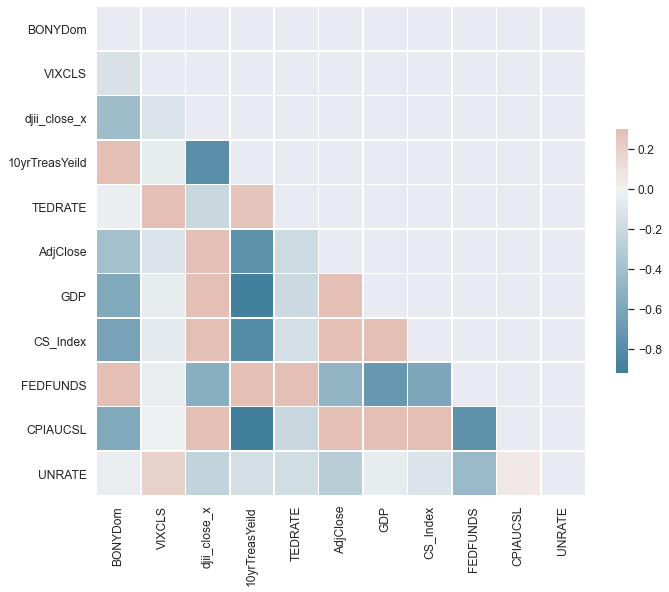

In [413]:
#BONYDom Correlation Matrix
BONYDomCorr = BONYDom.corr()

# Generate a mask for the upper triangle
mask = np.triu(np.ones_like(BONYDomCorr, dtype=bool))

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(11, 9))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(230, 20, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(BONYDomCorr, mask=mask, cmap=cmap, vmax=.3, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

Looking at our BONY domestic deposits heatmap we can see that our more saturated correlations include: 
Dow Jones Close (djii_close_x)
S&P 500 Close (AdjClose)
GDP
Case schiller home index (CS_Index) 
Consumer Price Index (CPIAUCSL) 

So we can investigate the BONY deposits further using those independent variables. 

C:\Users\Cathy\anaconda3\lib\site-packages\seaborn\distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


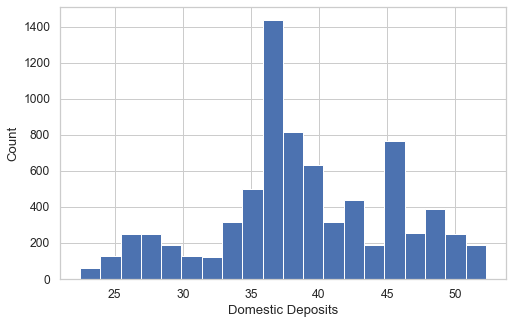

In [414]:
#Histogram of dependent variable to understand distribution: 
sns.set(style='whitegrid', palette="deep", font_scale=1.1, rc={"figure.figsize": [8, 5]})
sns.distplot(
    BONYDom['BONYDom'], norm_hist=False, kde=False, bins=20, hist_kws={"alpha": 1}
).set(xlabel='Domestic Deposits', ylabel='Count');

<AxesSubplot:xlabel='DATE', ylabel='BONYDom'>

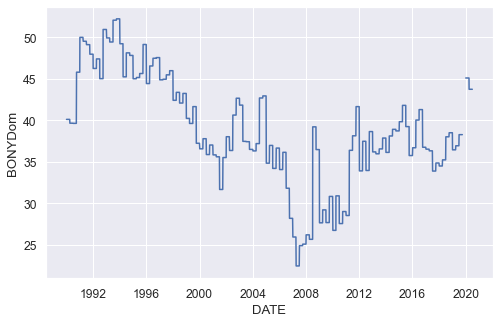

In [415]:
sns.set_style("darkgrid")
sns.lineplot(data = BONYDom, x='DATE', y='BONYDom')

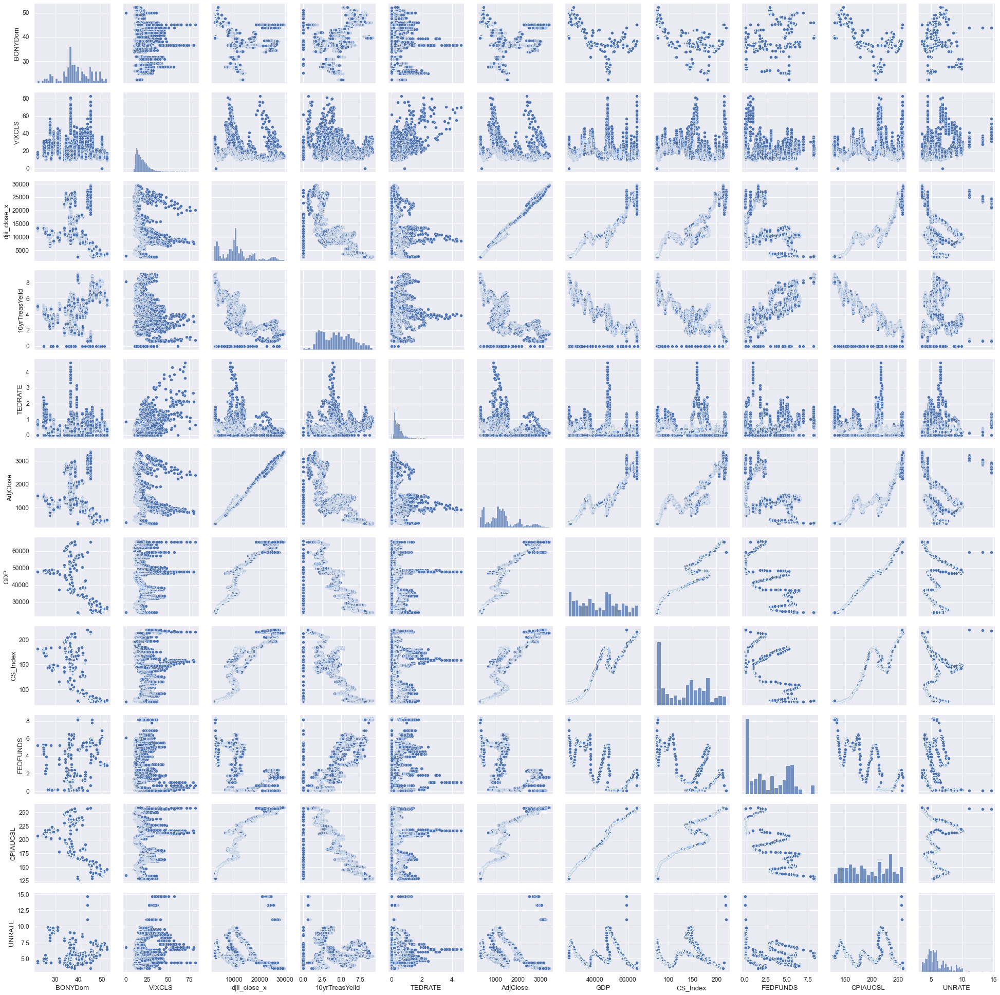

In [416]:
#Show univariate distribution of each variable
g = sns.PairGrid(BONYDom)
g.map_diag(sns.histplot)
g.map_offdiag(sns.scatterplot)

<AxesSubplot:>

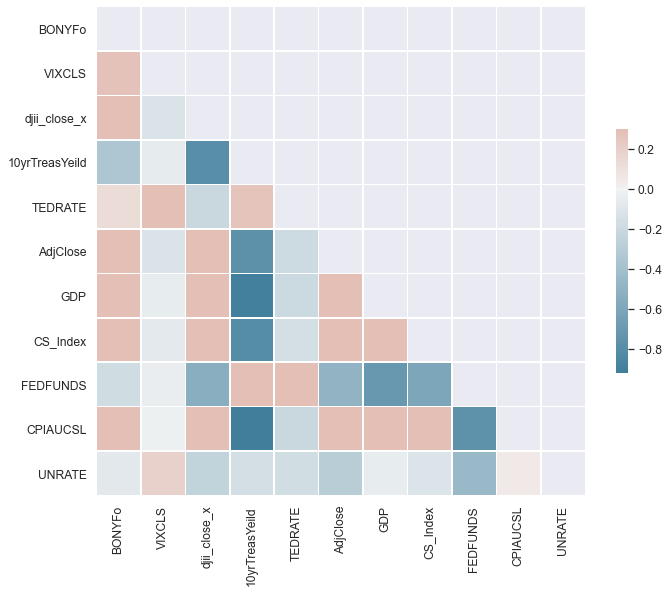

In [417]:
#BONYFo Correlation Matrix
BONYFoCorr = BONYFo.corr()

# Generate a mask for the upper triangle
mask = np.triu(np.ones_like(BONYFoCorr, dtype=bool))

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(11, 9))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(230, 20, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(BONYFoCorr, mask=mask, cmap=cmap, vmax=.3, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

Looking at our BONY foreign office deposits heatmap we can see that our more saturated correlations, which are mostly negative include: 
VIX (VIXCLS)
Dow Jones Close (djii_close_x)
10-year Treasury Yeild (10yrTreasYeild)
S&P 500 Close (AdjClose)
GDP
Case schiller home index (CS_Index) 
Consumer Price Index (CPIAUCSL) 

So we can investigate the BONY deposits further using those independent variables. 

C:\Users\Cathy\anaconda3\lib\site-packages\seaborn\distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


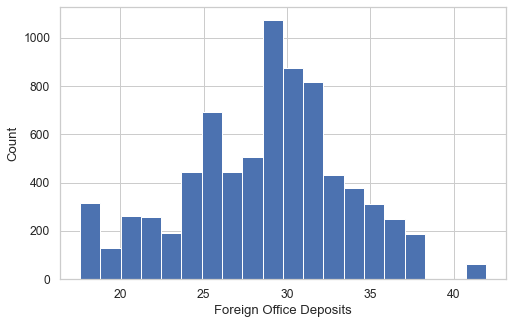

In [418]:
#Histogram of dependent variable to understand distribution: 
sns.set(style='whitegrid', palette="deep", font_scale=1.1, rc={"figure.figsize": [8, 5]})
sns.distplot(
    BONYFo['BONYFo'], norm_hist=False, kde=False, bins=20, hist_kws={"alpha": 1}
).set(xlabel='Foreign Office Deposits', ylabel='Count');

<AxesSubplot:xlabel='DATE', ylabel='BONYFo'>

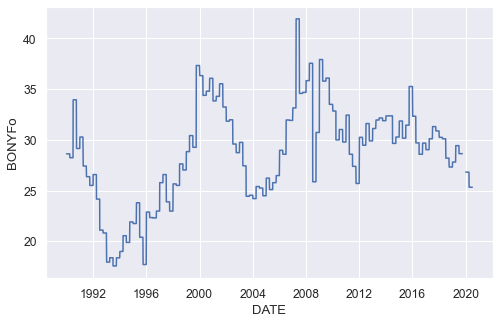

In [419]:
sns.set_style("darkgrid")
sns.lineplot(data = BONYFo, x='DATE', y='BONYFo')

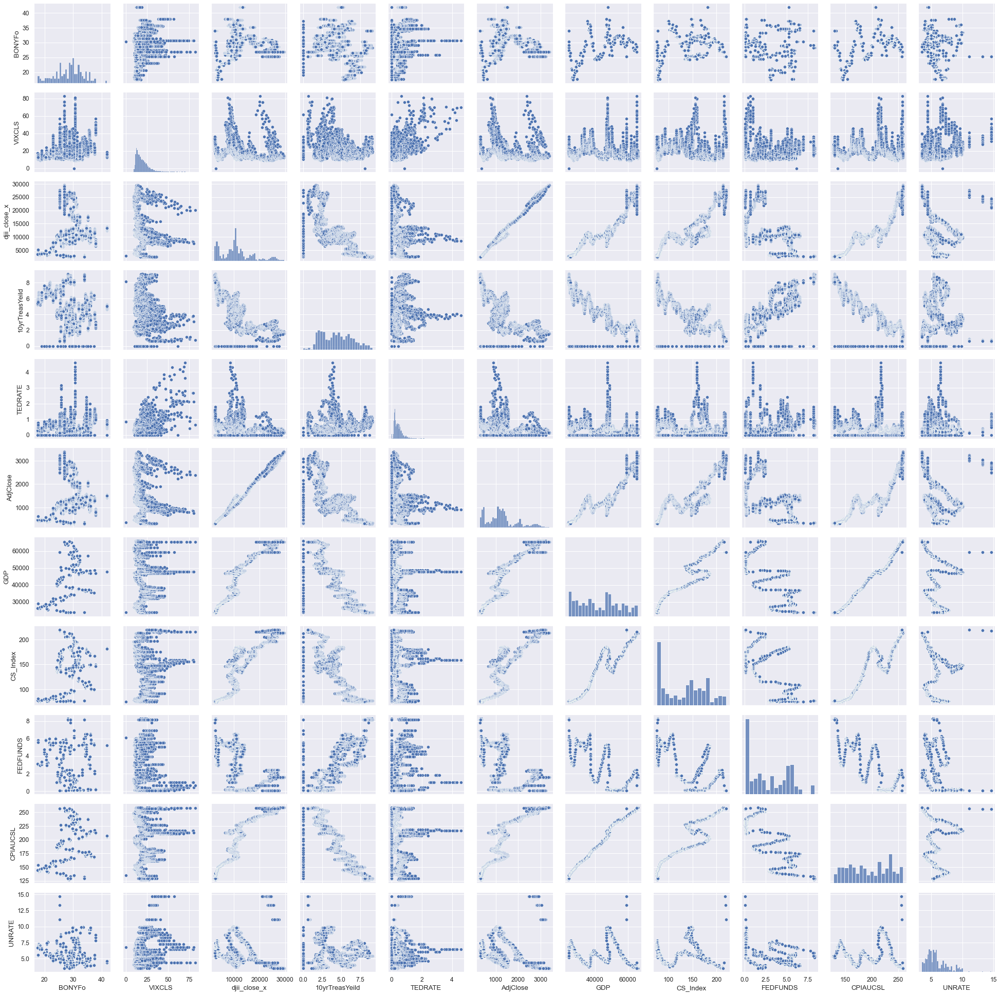

In [420]:
#Show univariate distribution of each variable
g = sns.PairGrid(BONYFo)
g.map_diag(sns.histplot)
g.map_offdiag(sns.scatterplot)

<AxesSubplot:>

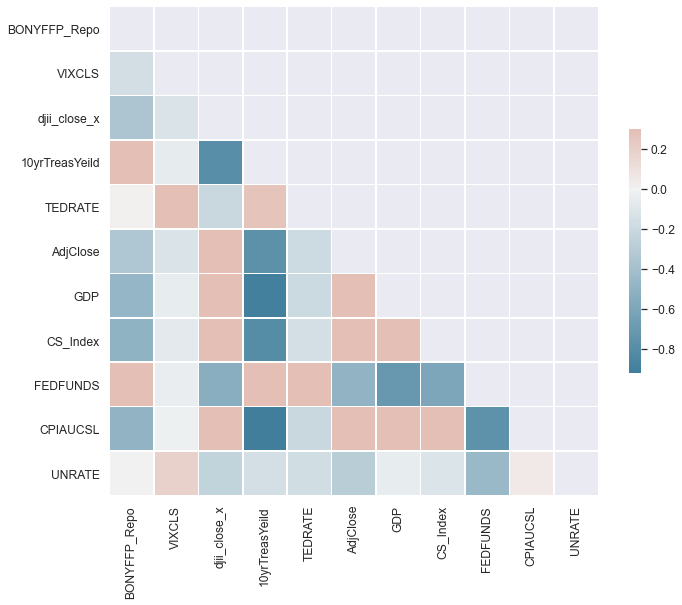

In [421]:
#BONYFFP Correlation Matrix
BONYFFPCorr = BONYFFP.corr()

# Generate a mask for the upper triangle
mask = np.triu(np.ones_like(BONYFFPCorr, dtype=bool))

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(11, 9))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(230, 20, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(BONYFFPCorr, mask=mask, cmap=cmap, vmax=.3, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

Looking at our BONY Fed Fund deposits heatmap we can see that our more saturated correlations, which are mostly negative include: 

Dow Jones Close (djii_close_x)
10-year Treasury Yeild (10yrTreasYeild)
S&P 500 Close (AdjClose)
GDP
Case schiller home index (CS_Index) 
Fed Funds Rate (FEDFUNDS)
Consumer Price Index (CPIAUCSL) 

So we can investigate the BONY deposits further using those independent variables

C:\Users\Cathy\anaconda3\lib\site-packages\seaborn\distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


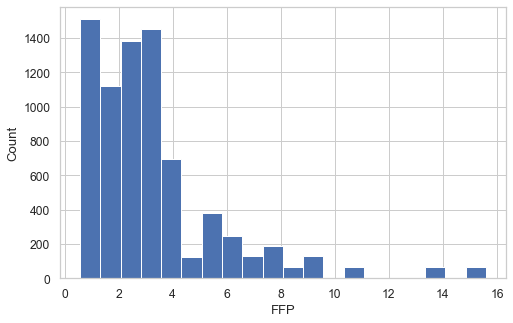

In [422]:
#Histogram of dependent variable to understand distribution: 
sns.set(style='whitegrid', palette="deep", font_scale=1.1, rc={"figure.figsize": [8, 5]})
sns.distplot(
    BONYFFP['BONYFFP_Repo'], norm_hist=False, kde=False, bins=20, hist_kws={"alpha": 1}
).set(xlabel='FFP', ylabel='Count');

<AxesSubplot:xlabel='DATE', ylabel='BONYFFP_Repo'>

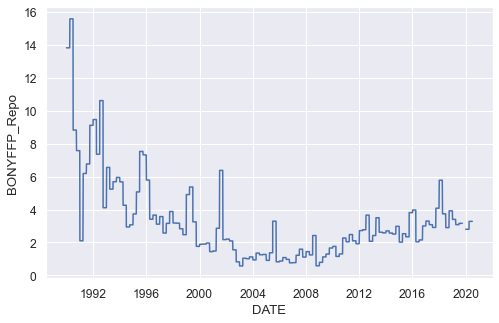

In [423]:
sns.set_style("darkgrid")
sns.lineplot(data = BONYFFP, x='DATE', y='BONYFFP_Repo')

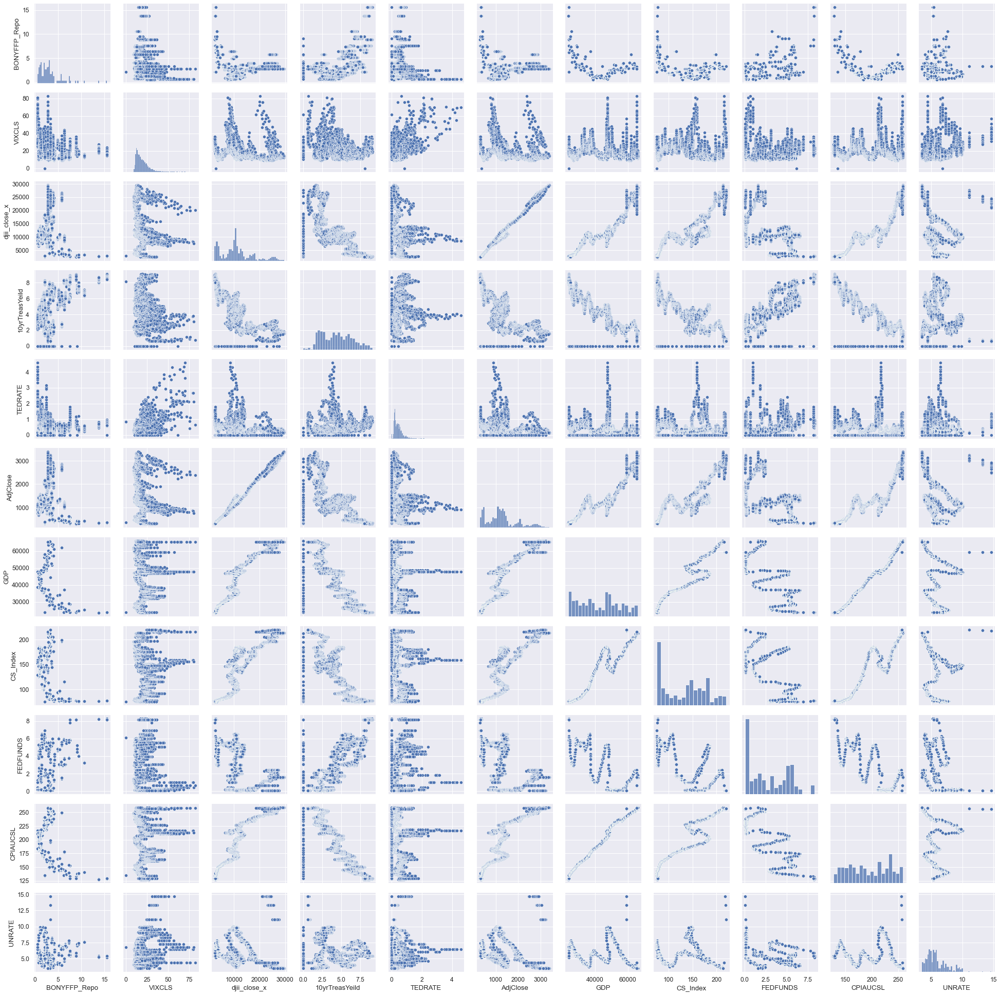

In [424]:
#Show univariate distribution of each variable
g = sns.PairGrid(BONYFFP)
g.map_diag(sns.histplot)
g.map_offdiag(sns.scatterplot)

<AxesSubplot:>

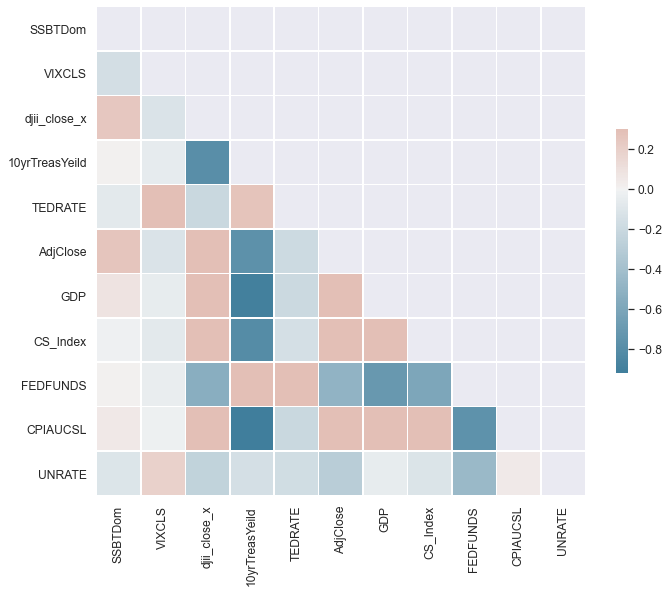

In [425]:
#SSBTDom Correlation Matrix
SSBTDomCorr = SSBTDom.corr()

# Generate a mask Domr the upper triangle
mask = np.triu(np.ones_like(SSBTDomCorr, dtype=bool))

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(11, 9))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(230, 20, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(SSBTDomCorr, mask=mask, cmap=cmap, vmax=.3, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

Surprisingly SSB&T domestic deposits are not highly correlated to any of the macro factors that I investigated.  Due to this I will skip out analysis on what moves SSB&T domestic deposits.  

C:\Users\Cathy\anaconda3\lib\site-packages\seaborn\distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


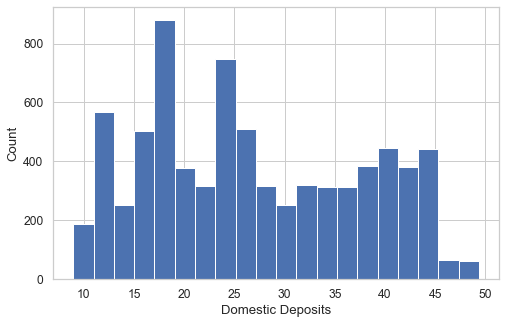

In [426]:
#Histogram of dependent variable to understand distribution: 
sns.set(style='whitegrid', palette="deep", font_scale=1.1, rc={"figure.figsize": [8, 5]})
sns.distplot(
    SSBTDom['SSBTDom'], norm_hist=False, kde=False, bins=20, hist_kws={"alpha": 1}
).set(xlabel='Domestic Deposits', ylabel='Count');

<AxesSubplot:xlabel='DATE', ylabel='SSBTDom'>

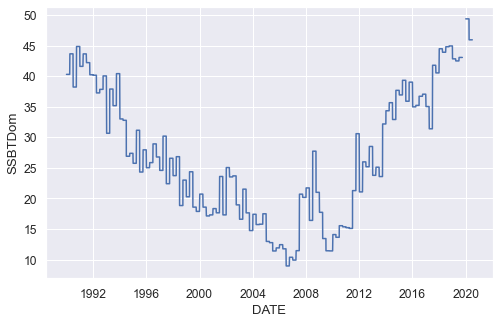

In [427]:
sns.set_style("darkgrid")
sns.lineplot(data = SSBTDom, x='DATE', y='SSBTDom')

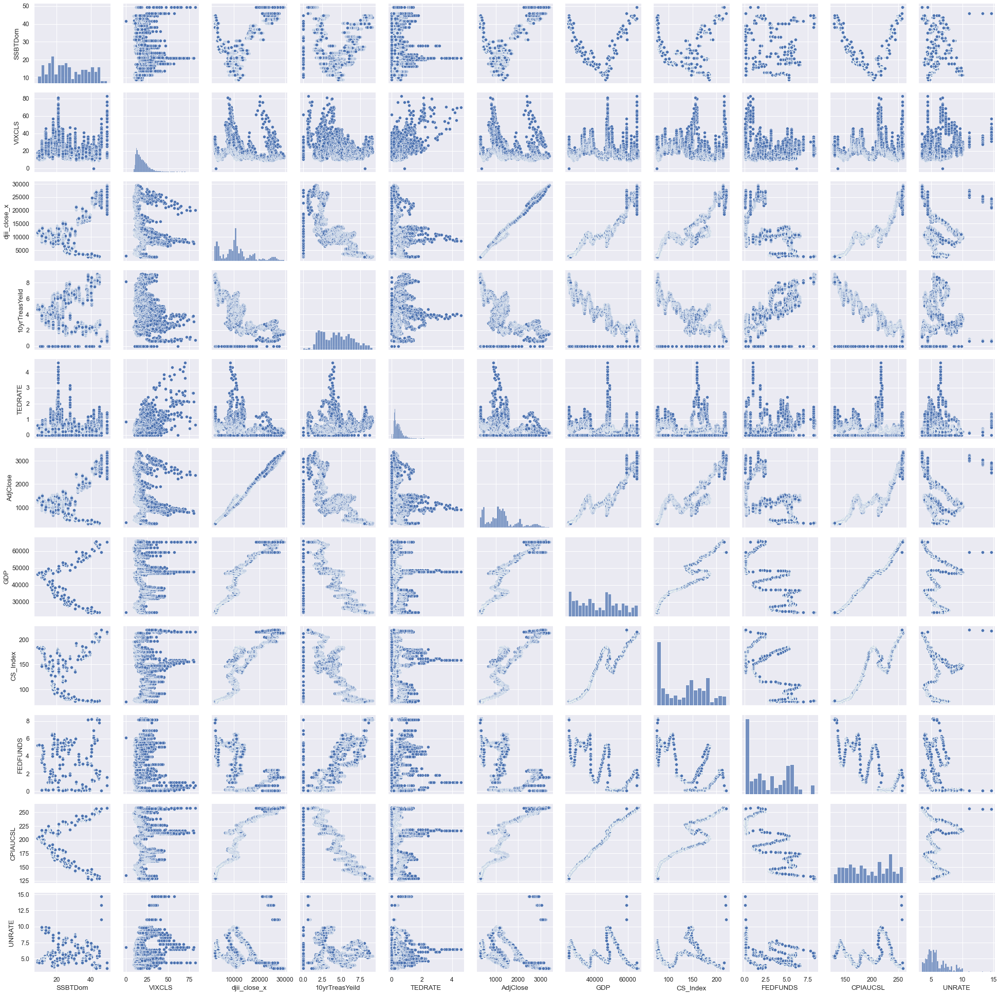

In [428]:
#Show univariate distribution of each variable
g = sns.PairGrid(SSBTDom)
g.map_diag(sns.histplot)
g.map_offdiag(sns.scatterplot)

<AxesSubplot:>

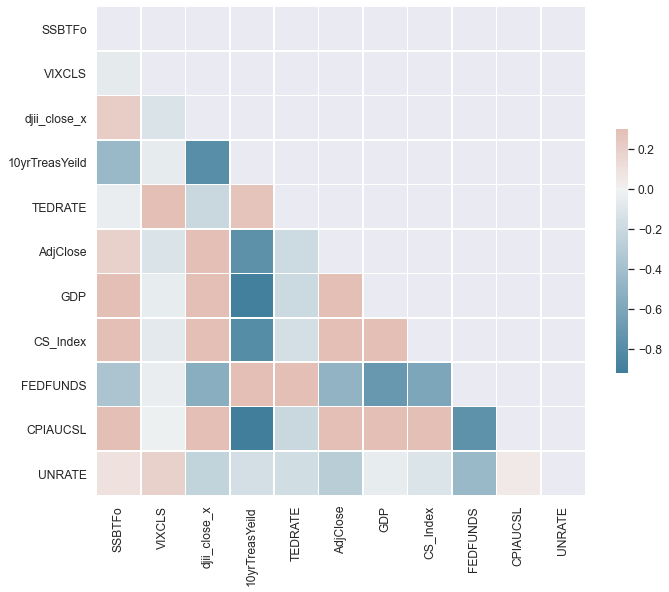

In [429]:
#SSBTFo Correlation Matrix
SSBTFoCorr = SSBTFo.corr()

# Generate a mask for the upper triangle
mask = np.triu(np.ones_like(SSBTFoCorr, dtype=bool))

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(11, 9))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(230, 20, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(SSBTFoCorr, mask=mask, cmap=cmap, vmax=.3, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

For SSB&T foreign office deposits do have some higher level corrrelations that we can investigate, including: 
10-Year Treasury Yeild
GDP
CS_Inex
Fed Funds Rate 
CPI

C:\Users\Cathy\anaconda3\lib\site-packages\seaborn\distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


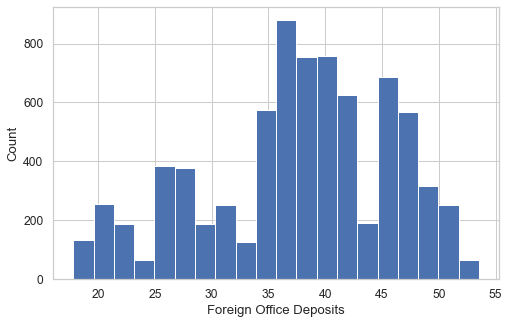

In [430]:
#Histogram of dependent variable to understand distribution: 
sns.set(style='whitegrid', palette="deep", font_scale=1.1, rc={"figure.figsize": [8, 5]})
sns.distplot(
    SSBTFo['SSBTFo'], norm_hist=False, kde=False, bins=20, hist_kws={"alpha": 1}
).set(xlabel='Foreign Office Deposits', ylabel='Count');

<AxesSubplot:xlabel='DATE', ylabel='SSBTFo'>

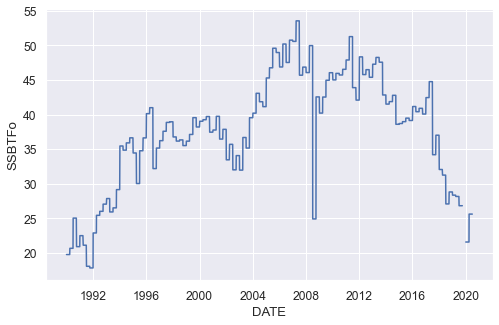

In [431]:
sns.set_style("darkgrid")
sns.lineplot(data = SSBTFo, x='DATE', y='SSBTFo')

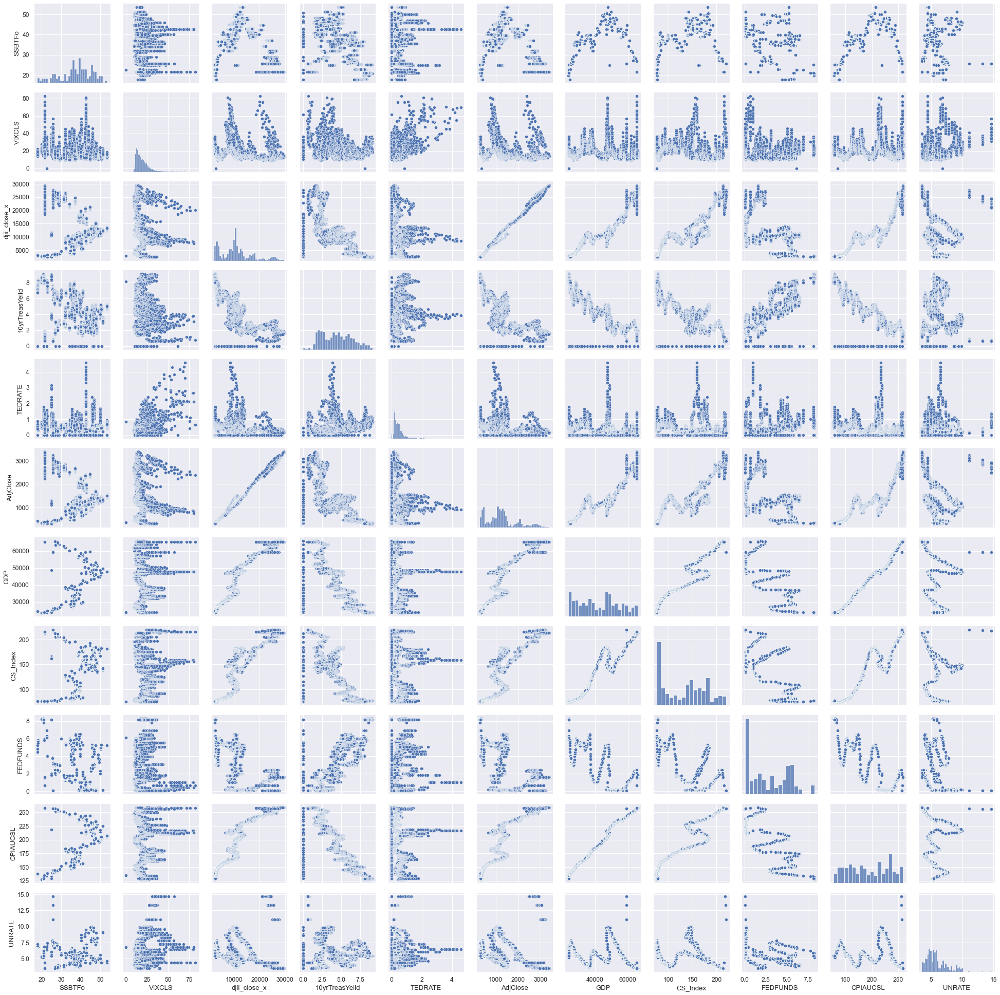

In [432]:
#Show univariate distribution of each variable
g = sns.PairGrid(SSBTFo)
g.map_diag(sns.histplot)
g.map_offdiag(sns.scatterplot)

<AxesSubplot:>

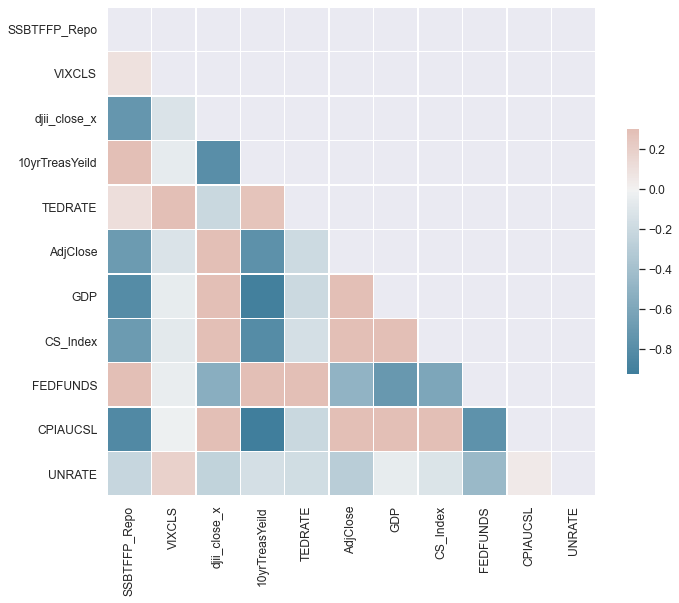

In [433]:
#SSBTFFP Correlation Matrix
SSBTFFPCorr = SSBTFFP.corr()

# Generate a mask for the upper triangle
mask = np.triu(np.ones_like(SSBTFFPCorr, dtype=bool))

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(11, 9))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(230, 20, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(SSBTFFPCorr, mask=mask, cmap=cmap, vmax=.3, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

For SSB&T Fed Funds deposits have stronger corrrelations that we can investigate, including: 
djii close 
adj_close_x - S&P
10-Year Treasury Yeild
GDP
CS_Index
Fed Funds Rate 
CPI

C:\Users\Cathy\anaconda3\lib\site-packages\seaborn\distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


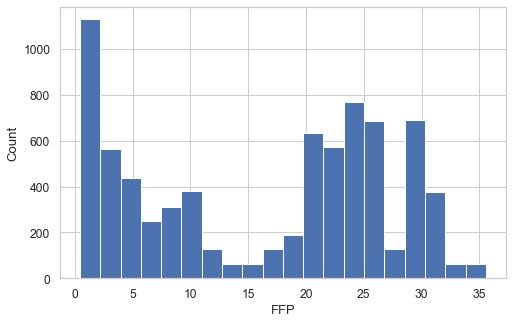

In [434]:
#Histogram of dependent variable to understand distribution: 
sns.set(style='whitegrid', palette="deep", font_scale=1.1, rc={"figure.figsize": [8, 5]})
sns.distplot(
    SSBTFFP['SSBTFFP_Repo'], norm_hist=False, kde=False, bins=20, hist_kws={"alpha": 1}
).set(xlabel='FFP', ylabel='Count');

<AxesSubplot:xlabel='DATE', ylabel='SSBTFFP_Repo'>

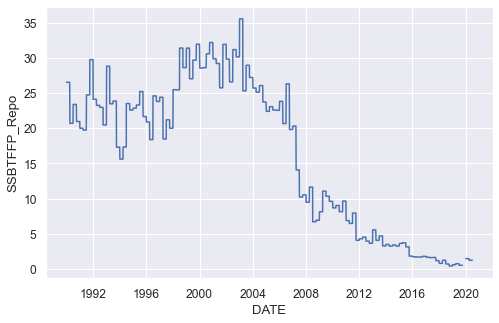

In [435]:
sns.set_style("darkgrid")
sns.lineplot(data = SSBTFFP, x='DATE', y='SSBTFFP_Repo')

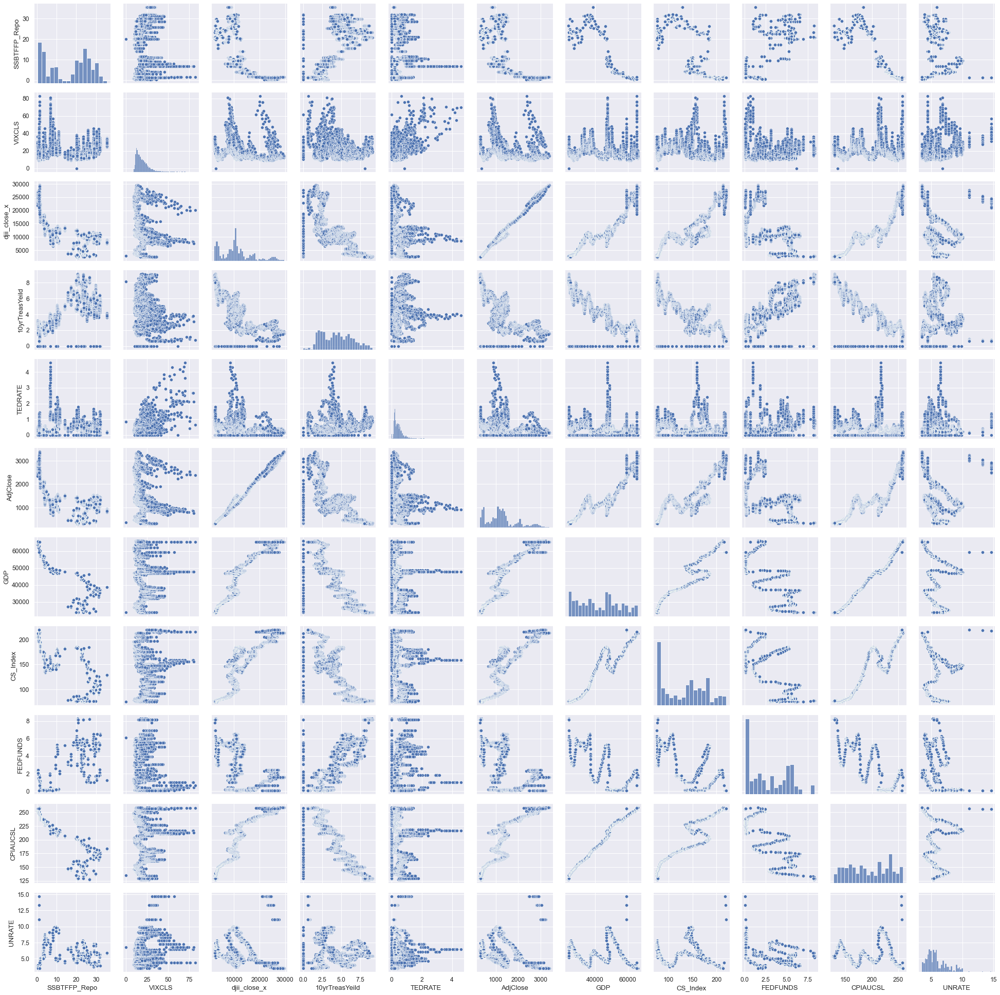

In [436]:
#Show univariate distribution of each variable
g = sns.PairGrid(SSBTFFP)
g.map_diag(sns.histplot)
g.map_offdiag(sns.scatterplot)

<AxesSubplot:>

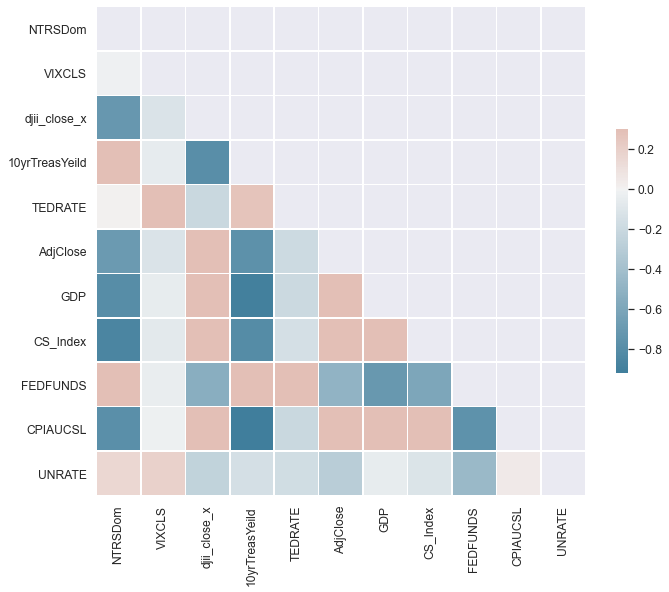

In [437]:
#NTRSDom Correlation Matrix
NTRSDomCorr = NTRSDom.corr()

# Generate a mask for the upper triangle
mask = np.triu(np.ones_like(NTRSDomCorr, dtype=bool))

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(11, 9))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(230, 20, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(NTRSDomCorr, mask=mask, cmap=cmap, vmax=.3, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

For Northern Trust we have some stronger correlations on Domestic deposits and can investigate: 
DJI Close 
S&P Close 
GDP
Case Schiller Index 
Fed Funds Rate 
CPI 

C:\Users\Cathy\anaconda3\lib\site-packages\seaborn\distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


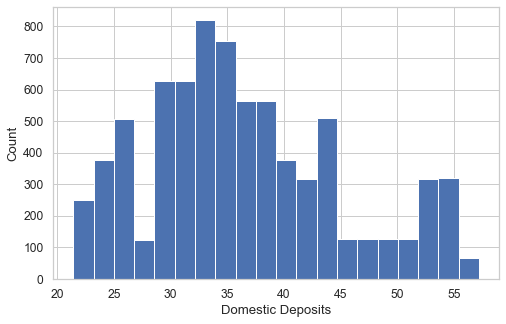

In [438]:
#Histogram of dependent variable to understand distribution: 
sns.set(style='whitegrid', palette="deep", font_scale=1.1, rc={"figure.figsize": [8, 5]})
sns.distplot(
    NTRSDom['NTRSDom'], norm_hist=False, kde=False, bins=20, hist_kws={"alpha": 1}
).set(xlabel='Domestic Deposits', ylabel='Count');

<AxesSubplot:xlabel='DATE', ylabel='NTRSDom'>

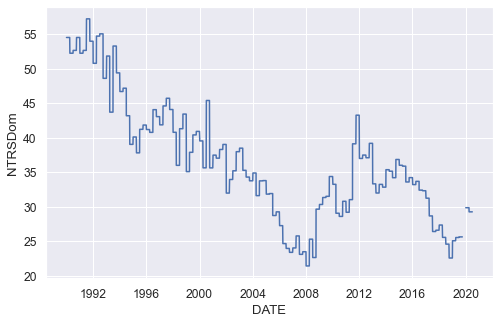

In [439]:
sns.set_style("darkgrid")
sns.lineplot(data = NTRSDom, x='DATE', y='NTRSDom')

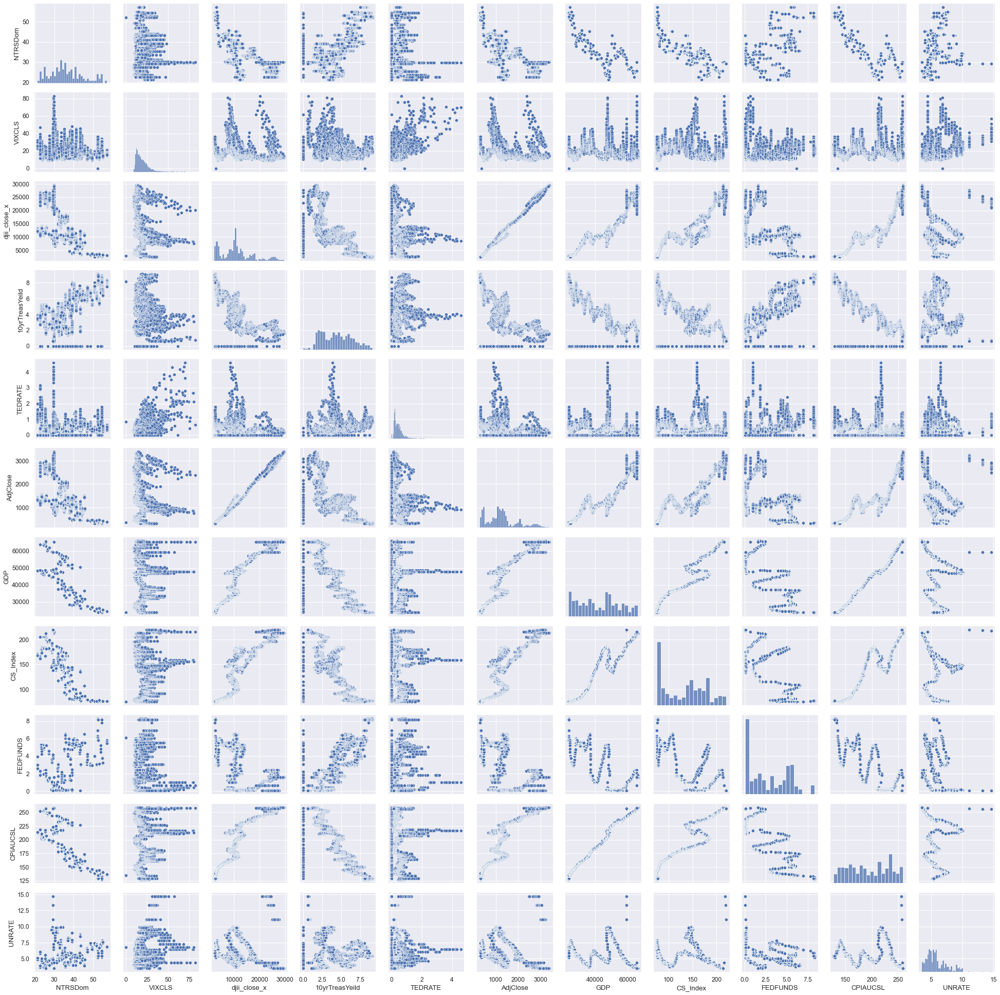

In [440]:
#Show univariate distribution of each variable
g = sns.PairGrid(NTRSDom)
g.map_diag(sns.histplot)
g.map_offdiag(sns.scatterplot)

<AxesSubplot:>

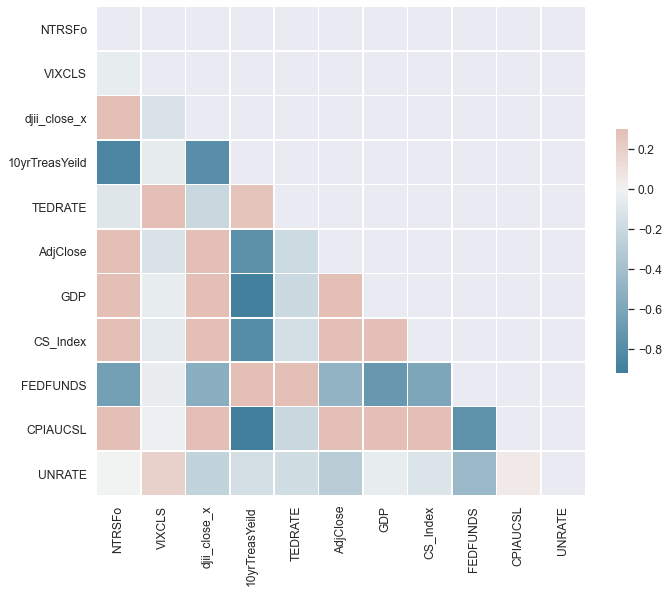

In [441]:
#NTRSFo Correlation Matrix
NTRSFoCorr = NTRSFo.corr()

# Generate a mask for the upper triangle
mask = np.triu(np.ones_like(NTRSFoCorr, dtype=bool))

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(11, 9))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(230, 20, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(NTRSFoCorr, mask=mask, cmap=cmap, vmax=.3, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

Similar to BONY, Northern Trust has a greater proportion of negatively correlated variables, but in this scenario since I know that these account for the buik of deposits we will investigate the following variables: 
Djii Close 
10-year treasury yeild 
S&P500 close 
GDP 
Case Schiller 
Fed Funds 
CPI 

C:\Users\Cathy\anaconda3\lib\site-packages\seaborn\distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


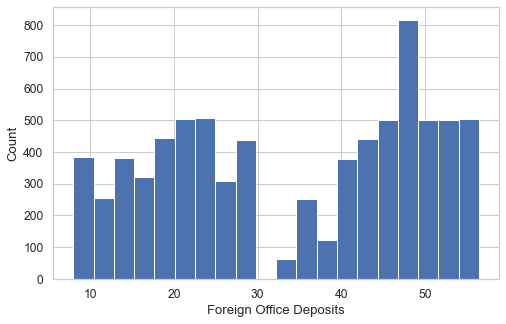

In [442]:
#Histogram of dependent variable to understand distribution: 
sns.set(style='whitegrid', palette="deep", font_scale=1.1, rc={"figure.figsize": [8, 5]})
sns.distplot(
    NTRSFo['NTRSFo'], norm_hist=False, kde=False, bins=20, hist_kws={"alpha": 1}
).set(xlabel='Foreign Office Deposits', ylabel='Count');

<AxesSubplot:xlabel='DATE', ylabel='NTRSFo'>

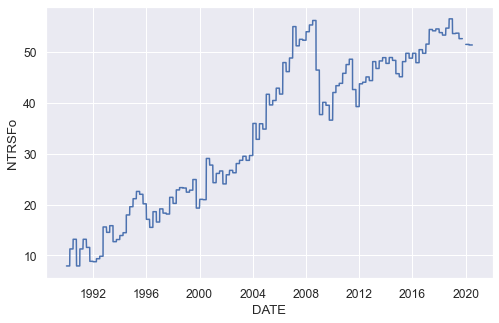

In [443]:
sns.set_style("darkgrid")
sns.lineplot(data = NTRSFo, x='DATE', y='NTRSFo')

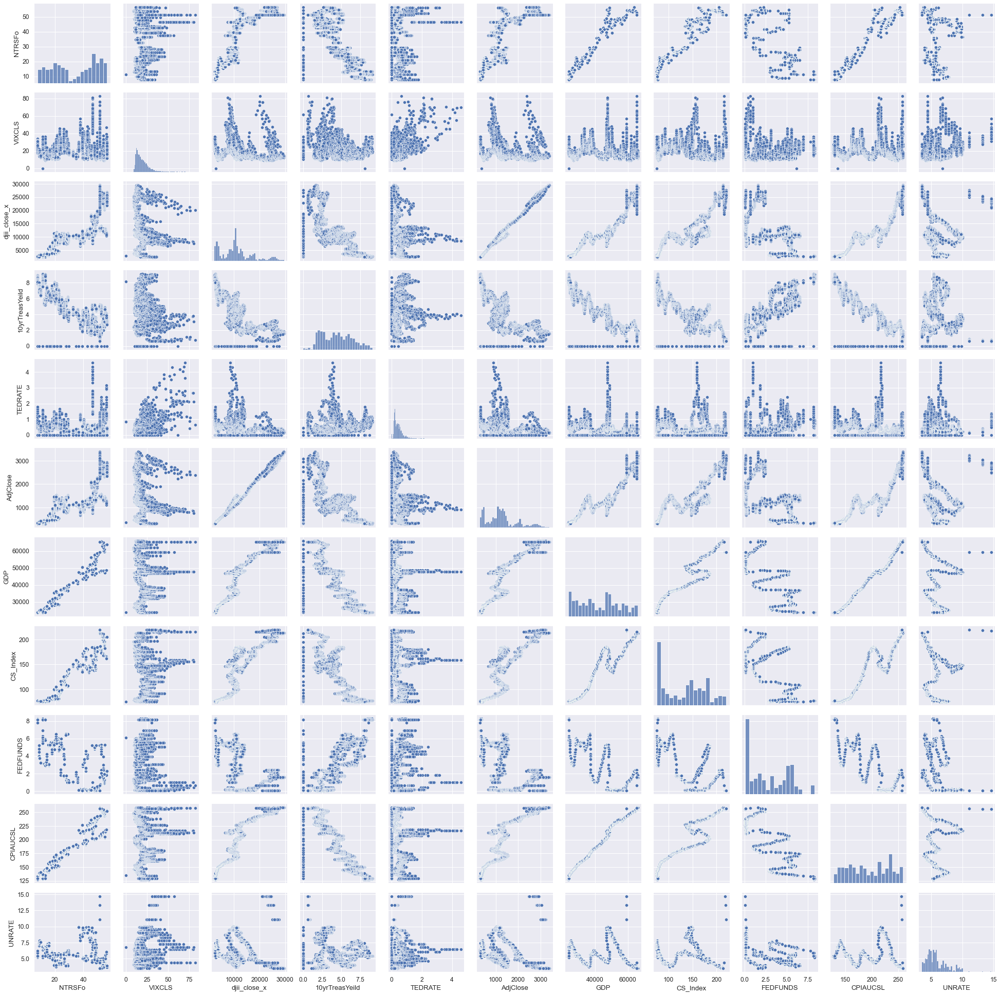

In [444]:
#Show univariate distribution of each variable
g = sns.PairGrid(NTRSFo)
g.map_diag(sns.histplot)
g.map_offdiag(sns.scatterplot)

<AxesSubplot:>

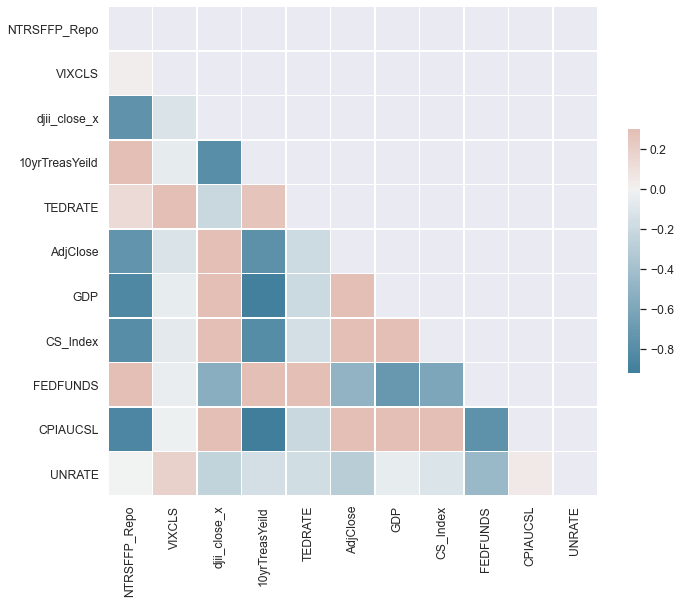

In [445]:
#NTRSFFP Correlation Matrix
NTRSFFPCorr = NTRSFFP.corr()

# Generate a mask for the upper triangle
mask = np.triu(np.ones_like(NTRSFFPCorr, dtype=bool))

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(11, 9))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(230, 20, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(NTRSFFPCorr, mask=mask, cmap=cmap, vmax=.3, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

C:\Users\Cathy\anaconda3\lib\site-packages\seaborn\distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


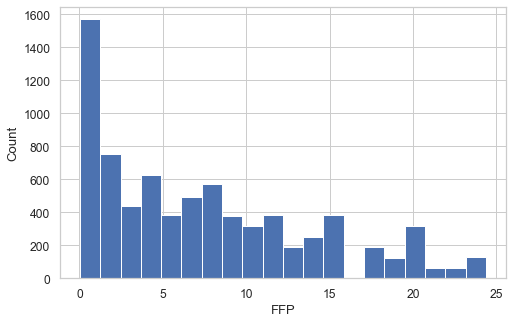

In [446]:
#Histogram of dependent variable to understand distribution: 
sns.set(style='whitegrid', palette="deep", font_scale=1.1, rc={"figure.figsize": [8, 5]})
sns.distplot(
    NTRSFFP['NTRSFFP_Repo'], norm_hist=False, kde=False, bins=20, hist_kws={"alpha": 1}
).set(xlabel='FFP', ylabel='Count');

<AxesSubplot:xlabel='DATE', ylabel='NTRSFFP_Repo'>

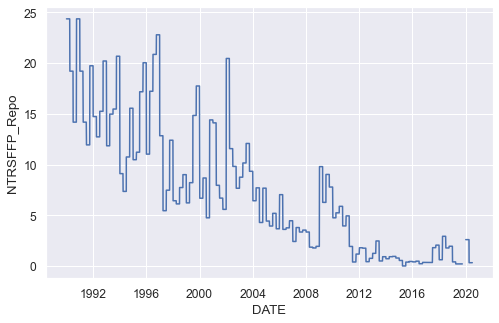

In [447]:
sns.set_style("darkgrid")
sns.lineplot(data = NTRSFFP, x='DATE', y='NTRSFFP_Repo')

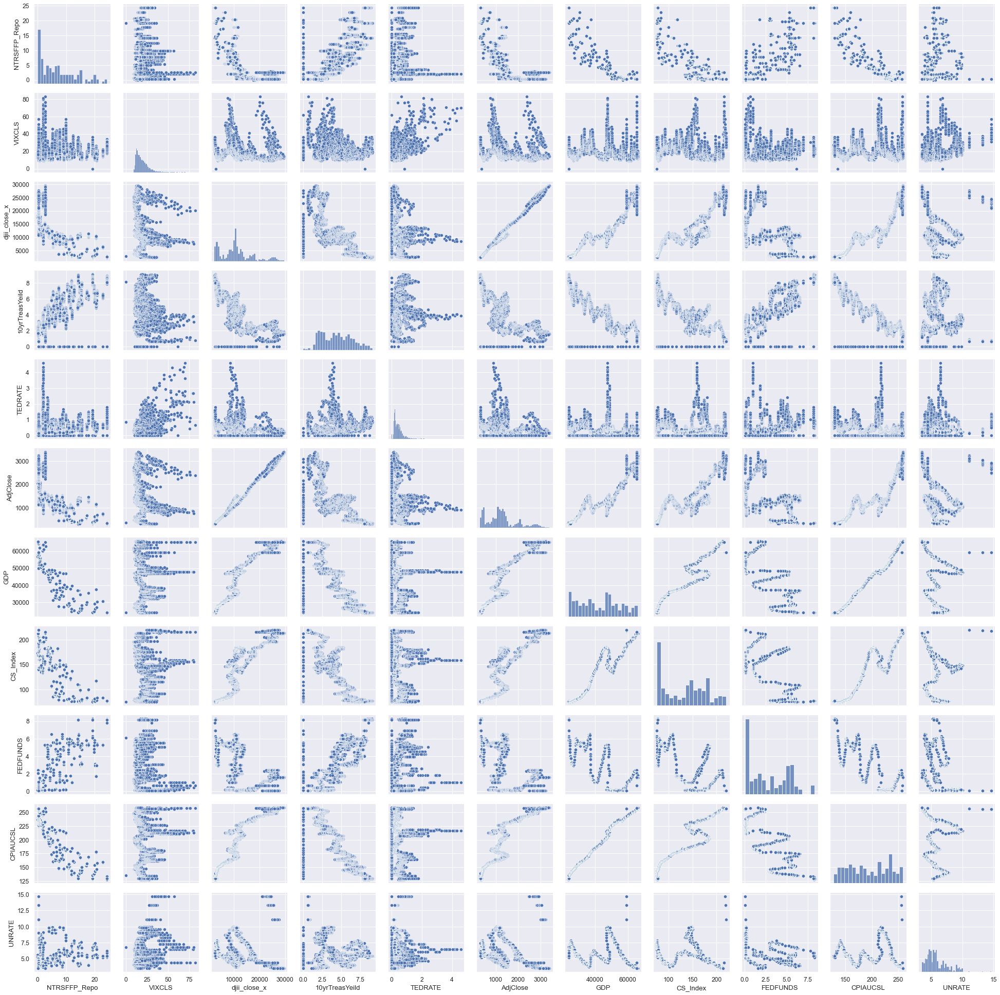

In [448]:
#Show univariate distribution of each variable
g = sns.PairGrid(NTRSFFP)
g.map_diag(sns.histplot)
g.map_offdiag(sns.scatterplot)

These time series plots might be interesting plotted against each other by institution. Lets give that a try: 

### Domestic Deposits by Bank: 

<AxesSubplot:>

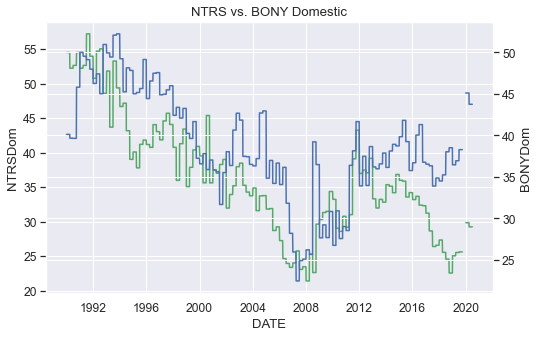

In [449]:
sns.set_style("darkgrid")
sns.lineplot(data = data, x='DATE', y='NTRSDom', color = 'g').set_title('NTRS vs. BONY Domestic')
ax2 = plt.twinx()
sns.lineplot(data = data, x = 'DATE', y = "BONYDom", color = 'b')
ax

<AxesSubplot:>

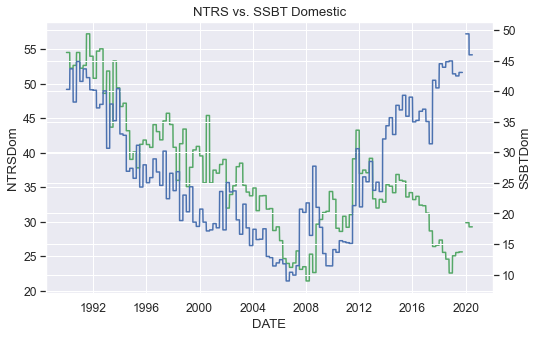

In [450]:
sns.set_style("darkgrid")
sns.lineplot(data = data, x='DATE', y='NTRSDom', color = 'g').set_title('NTRS vs. SSBT Domestic')
ax2 = plt.twinx()
sns.lineplot(data = data, x = 'DATE', y = "SSBTDom", color = 'b')
ax

### Foreign Office Deposits by Bank:

<AxesSubplot:>

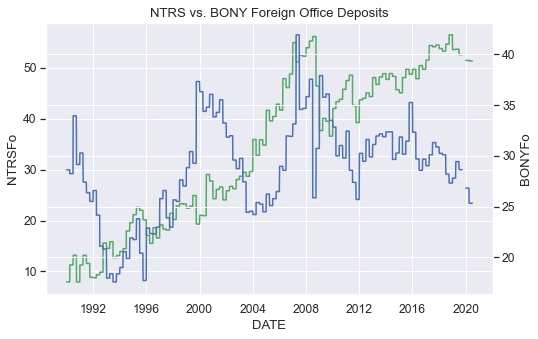

In [451]:
sns.set_style("darkgrid")
sns.lineplot(data = data, x='DATE', y='NTRSFo', color = 'g').set_title('NTRS vs. BONY Foreign Office Deposits')
ax2 = plt.twinx()
sns.lineplot(data = data, x = 'DATE', y = "BONYFo", color = 'b')
ax

<AxesSubplot:>

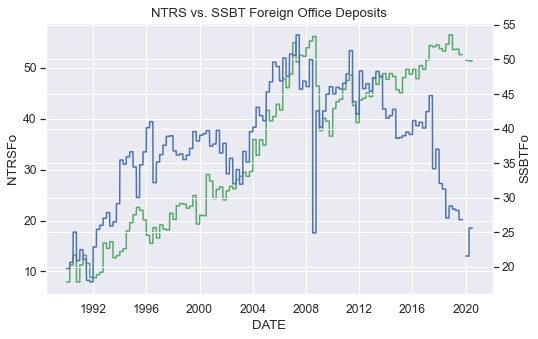

In [452]:
sns.set_style("darkgrid")
sns.lineplot(data = data, x='DATE', y='NTRSFo', color = 'g').set_title('NTRS vs. SSBT Foreign Office Deposits')
ax2 = plt.twinx()
sns.lineplot(data = data, x = 'DATE', y = "SSBTFo", color = 'b')
ax

### FFP & Repo by Bank:

<AxesSubplot:>

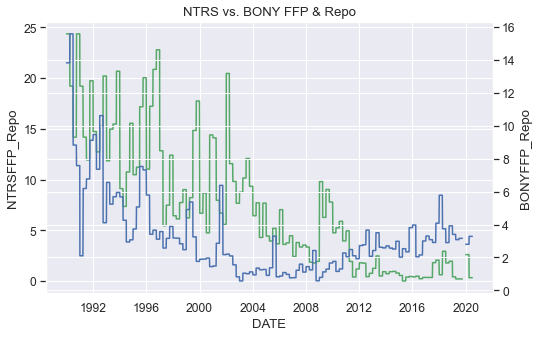

In [453]:
sns.set_style("darkgrid")
sns.lineplot(data = data, x='DATE', y='NTRSFFP_Repo', color = 'g').set_title('NTRS vs. BONY FFP & Repo')
ax2 = plt.twinx()
sns.lineplot(data = data, x = 'DATE', y = "BONYFFP_Repo", color = 'b')
ax

<AxesSubplot:>

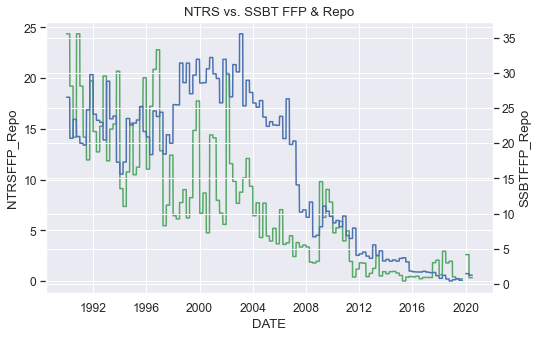

In [454]:
sns.set_style("darkgrid")
sns.lineplot(data = data, x='DATE', y='NTRSFFP_Repo', color = 'g').set_title('NTRS vs. SSBT FFP & Repo')
ax2 = plt.twinx()
sns.lineplot(data = data, x = 'DATE', y = "SSBTFFP_Repo", color = 'b')
ax

### What if we transform data into quarterly averages??? 
We can resample based on the date and transform into quarterly data, across the board there are some independent variables that have no bearing on the correlations within the data.  Now we will transform, and strip out some of the data that does not seem to have much impact on our dependent variables we will transform our dataframe and re-run some of this analysis to see if there are any material changes in the correlations. 

In addition knowing that our FFP and Repo deposits are likely structural and not a strong indication of client behavior based on macroeconomic factors we can remove the FFP analysis from our views for this 2nd round of descriptive analysis with quarterly data. 

In [455]:
data.set_index('DATE', inplace=True)
data.head()

,Unnamed:0,BONYDom,BONYFo,BONYFFP_Repo,SSBTDom,SSBTFo,SSBTFFP_Repo,NTRSDom,NTRSFo,NTRSFFP_Repo,...,djii_close_x,djii_close_y,10yrTreasYeild,TEDRATE,AdjClose,GDP,CS_Index,FEDFUNDS,CPIAUCSL,UNRATE
DATE,,,,,,,,,,,,,,,,,,,,,
1990-01-01,0,40.12,28.62,13.83,40.28,19.75,26.54,54.51,7.94,24.36,...,2810.15,2810.15,7.94,0.80,359.690002,23591.0,76.527,8.23,127.5,5.4
1990-01-02,1,40.12,28.62,13.83,40.28,19.75,26.54,54.51,7.94,24.36,...,2810.15,2810.15,7.94,0.80,359.690002,23591.0,76.527,8.23,127.5,5.4
1990-01-03,2,40.12,28.62,13.83,40.28,19.75,26.54,54.51,7.94,24.36,...,2809.73,2809.73,7.99,0.75,358.760010,23591.0,76.527,8.23,127.5,5.4
1990-01-04,3,40.12,28.62,13.83,40.28,19.75,26.54,54.51,7.94,24.36,...,2796.08,2796.08,7.98,0.79,355.670013,23591.0,76.527,8.23,127.5,5.4
1990-01-05,4,40.12,28.62,13.83,40.28,19.75,26.54,54.51,7.94,24.36,...,2773.25,2773.25,7.99,0.84,352.200012,23591.0,76.527,8.23,127.5,5.4


In [456]:
data2 = data.resample('QS').sum()

In [457]:
data2.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 122 entries, 1990-01-01 to 2020-04-01
Freq: QS-JAN
Data columns (total 21 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   Unnamed:0       122 non-null    int64  
 1   BONYDom         122 non-null    float64
 2   BONYFo          122 non-null    float64
 3   BONYFFP_Repo    122 non-null    float64
 4   SSBTDom         122 non-null    float64
 5   SSBTFo          122 non-null    float64
 6   SSBTFFP_Repo    122 non-null    float64
 7   NTRSDom         122 non-null    float64
 8   NTRSFo          122 non-null    float64
 9   NTRSFFP_Repo    122 non-null    float64
 10  VIXCLS          122 non-null    float64
 11  djii_close_x    122 non-null    float64
 12  djii_close_y    122 non-null    float64
 13  10yrTreasYeild  122 non-null    float64
 14  TEDRATE         122 non-null    float64
 15  AdjClose        122 non-null    float64
 16  GDP             122 non-null    float64
 17  CS_

In [458]:
#Remove Ted Spread and Unemployment from data series along with first column unamed 
data2 = data2.drop(['UNRATE','djii_close_y', 'TEDRATE'], axis = 1) 

In [459]:
data2.drop(data2.columns[data2.columns.str.contains('unnamed',case = False)],axis = 1, inplace = True)

In [646]:
data2.describe()

,BONYDom,BONYFo,BONYFFP_Repo,SSBTDom,SSBTFo,SSBTFFP_Repo,NTRSDom,NTRSFo,NTRSFFP_Repo,VIXCLS,djii_close_x,10yrTreasYeild,AdjClose,GDP,CS_Index,FEDFUNDS,CPIAUCSL
count,121.000000,121.00000,121.000000,121.000000,121.000000,121.000000,121.000000,121.000000,121.000000,121.000000,1.210000e+02,121.000000,121.000000,1.210000e+02,121.000000,121.000000,121.000000
mean,2449.572810,1802.24686,207.258430,1695.392893,2369.820331,1027.045041,2298.195785,2154.865620,469.641901,1222.062727,7.055547e+05,281.034215,80514.593950,2.674906e+06,8423.044719,182.160000,12211.776322
std,433.294846,298.32716,161.608447,674.358203,516.192468,677.745845,561.109546,948.725361,409.602868,454.249245,3.874660e+05,124.523435,43012.884971,7.612491e+05,2725.179680,151.154874,2369.648882
min,1414.350000,1112.90000,34.770000,563.850000,1139.840000,27.720000,1305.400000,500.220000,1.890000,649.400000,1.617008e+05,43.320000,20259.970117,1.455948e+06,4587.805000,3.810000,8053.600000
25%,2223.450000,1606.40000,100.170000,1111.320000,2059.520000,265.980000,1917.600000,1303.860000,115.290000,888.170000,4.732237e+05,168.690000,52506.369993,2.000832e+06,5432.907000,23.900000,10213.700000
50%,2395.260000,1829.12000,167.680000,1585.710000,2452.810000,1249.290000,2193.920000,2298.480000,386.820000,1112.980000,6.649352e+05,273.430000,77093.479736,2.722880e+06,8780.130000,150.960000,12249.900000
75%,2756.250000,2003.24000,239.360000,2296.960000,2745.610000,1574.400000,2634.660000,3031.180000,735.320000,1436.480000,8.396662e+05,374.530000,93836.200195,3.195328e+06,10705.907000,329.120000,14303.982000
max,3333.120000,2641.59000,997.760000,3060.320000,3373.650000,2168.550000,3833.070000,3594.880000,1559.040000,3695.150000,1.707247e+06,565.030000,189463.889405,4.193664e+06,13774.105000,531.640000,16404.242000


In [460]:
data2.head()

,BONYDom,BONYFo,BONYFFP_Repo,SSBTDom,SSBTFo,SSBTFFP_Repo,NTRSDom,NTRSFo,NTRSFFP_Repo,VIXCLS,djii_close_x,10yrTreasYeild,AdjClose,GDP,CS_Index,FEDFUNDS,CPIAUCSL
DATE,,,,,,,,,,,,,,,,,
1990-01-01,2527.56,1803.06,871.29,2537.64,1244.25,1672.02,3434.13,500.22,1534.68,1387.90,168156.28,530.22,21226.900085,1486510.0,4823.864,518.94,8053.6
1990-04-01,2538.24,1807.36,997.76,2792.96,1321.60,1325.44,3342.72,721.92,1229.44,1202.33,179120.85,555.12,22375.880006,1527552.0,4941.923,525.31,8259.0
1990-07-01,2576.60,2206.75,573.95,2483.65,1626.30,1520.35,3421.60,856.70,922.35,1624.84,177565.12,565.03,21879.229952,1551555.0,5024.789,531.64,8398.8
1990-10-01,2931.84,1865.60,485.12,2869.76,1336.96,1341.44,3488.64,508.16,1559.04,1671.25,161700.77,521.17,20259.970117,1503693.0,4945.818,523.08,8271.3
1991-01-01,3050.61,1847.08,128.10,2536.99,1371.28,1220.61,3186.03,688.08,1171.81,1350.95,169727.23,481.37,21489.260009,1455948.0,4587.805,390.83,8220.6


In [508]:
data2.describe()

,BONYDom,BONYFo,BONYFFP_Repo,SSBTDom,SSBTFo,SSBTFFP_Repo,NTRSDom,NTRSFo,NTRSFFP_Repo,VIXCLS,djii_close_x,10yrTreasYeild,AdjClose,GDP,CS_Index,FEDFUNDS,CPIAUCSL
count,122.000000,122.000000,122.000000,122.000000,122.000000,122.000000,122.000000,122.000000,122.000000,122.000000,1.220000e+02,122.000000,122.000000,1.220000e+02,122.000000,122.000000,122.000000
mean,2429.494344,1787.474344,205.559590,1681.496230,2350.395574,1018.626639,2279.358115,2137.202787,465.792377,1219.382623,7.142174e+05,279.641311,81471.821534,2.687638e+06,8465.355680,181.532787,12246.926279
std,485.156140,338.950267,162.029453,688.883844,557.032982,681.314402,596.267189,964.729064,410.116862,453.335845,3.975477e+05,124.958547,44120.345073,7.710283e+05,2753.839851,150.688306,2391.560638
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,649.400000,1.617008e+05,43.320000,20259.970117,1.455948e+06,4587.805000,3.810000,8053.600000
25%,2222.422500,1601.622500,99.442500,1108.785000,2050.880000,259.275000,1879.417500,1278.052500,115.222500,889.900000,4.781572e+05,168.375000,52555.615035,2.004057e+06,5439.495000,24.275000,10220.225000
50%,2388.015000,1826.510000,166.400000,1583.505000,2437.925000,1246.770000,2191.040000,2297.400000,382.210000,1107.185000,6.652690e+05,272.000000,77154.754821,2.759072e+06,8803.392500,148.785000,12308.800000
75%,2754.387500,2000.287500,239.070000,2286.080000,2744.487500,1570.315000,2627.457500,3030.802500,728.362500,1435.925000,8.469255e+05,373.905000,94200.624940,3.230270e+06,10794.451250,328.615000,14344.428000
max,3333.120000,2641.590000,997.760000,3060.320000,3373.650000,2168.550000,3833.070000,3594.880000,1559.040000,3695.150000,1.762394e+06,565.030000,197296.359136,4.228096e+06,13774.105000,531.640000,16500.071000


In [509]:
#delete 0's 
data2 = data2[data2!=0].dropna()

In [510]:
#Check to ensure 0 values for deposits are deleted from data frame, showing no min 0 values in our summary stats: 
data2.describe()

,BONYDom,BONYFo,BONYFFP_Repo,SSBTDom,SSBTFo,SSBTFFP_Repo,NTRSDom,NTRSFo,NTRSFFP_Repo,VIXCLS,djii_close_x,10yrTreasYeild,AdjClose,GDP,CS_Index,FEDFUNDS,CPIAUCSL
count,121.000000,121.00000,121.000000,121.000000,121.000000,121.000000,121.000000,121.000000,121.000000,121.000000,1.210000e+02,121.000000,121.000000,1.210000e+02,121.000000,121.000000,121.000000
mean,2449.572810,1802.24686,207.258430,1695.392893,2369.820331,1027.045041,2298.195785,2154.865620,469.641901,1222.062727,7.055547e+05,281.034215,80514.593950,2.674906e+06,8423.044719,182.160000,12211.776322
std,433.294846,298.32716,161.608447,674.358203,516.192468,677.745845,561.109546,948.725361,409.602868,454.249245,3.874660e+05,124.523435,43012.884971,7.612491e+05,2725.179680,151.154874,2369.648882
min,1414.350000,1112.90000,34.770000,563.850000,1139.840000,27.720000,1305.400000,500.220000,1.890000,649.400000,1.617008e+05,43.320000,20259.970117,1.455948e+06,4587.805000,3.810000,8053.600000
25%,2223.450000,1606.40000,100.170000,1111.320000,2059.520000,265.980000,1917.600000,1303.860000,115.290000,888.170000,4.732237e+05,168.690000,52506.369993,2.000832e+06,5432.907000,23.900000,10213.700000
50%,2395.260000,1829.12000,167.680000,1585.710000,2452.810000,1249.290000,2193.920000,2298.480000,386.820000,1112.980000,6.649352e+05,273.430000,77093.479736,2.722880e+06,8780.130000,150.960000,12249.900000
75%,2756.250000,2003.24000,239.360000,2296.960000,2745.610000,1574.400000,2634.660000,3031.180000,735.320000,1436.480000,8.396662e+05,374.530000,93836.200195,3.195328e+06,10705.907000,329.120000,14303.982000
max,3333.120000,2641.59000,997.760000,3060.320000,3373.650000,2168.550000,3833.070000,3594.880000,1559.040000,3695.150000,1.707247e+06,565.030000,189463.889405,4.193664e+06,13774.105000,531.640000,16404.242000


In [511]:
#Subset for each bank
BONYDom2=data2[['BONYDom','VIXCLS',
'djii_close_x','10yrTreasYeild','AdjClose','GDP',
'CS_Index','FEDFUNDS','CPIAUCSL']]

BONYFo2=data2[['BONYFo','VIXCLS',
'djii_close_x','10yrTreasYeild','AdjClose','GDP',
'CS_Index','FEDFUNDS','CPIAUCSL']]

SSBTDom2=data2[['SSBTDom','VIXCLS',
'djii_close_x','10yrTreasYeild','AdjClose','GDP',
'CS_Index','FEDFUNDS','CPIAUCSL']]

SSBTFo2=data2[['SSBTFo','VIXCLS',
'djii_close_x','10yrTreasYeild','AdjClose','GDP',
'CS_Index','FEDFUNDS','CPIAUCSL']]

NTRSDom2=data2[['NTRSDom','VIXCLS',
'djii_close_x','10yrTreasYeild','AdjClose','GDP',
'CS_Index','FEDFUNDS','CPIAUCSL']]

NTRSFo2=data2[['NTRSFo','VIXCLS',
'djii_close_x','10yrTreasYeild','AdjClose','GDP',
'CS_Index','FEDFUNDS','CPIAUCSL']]

<AxesSubplot:>

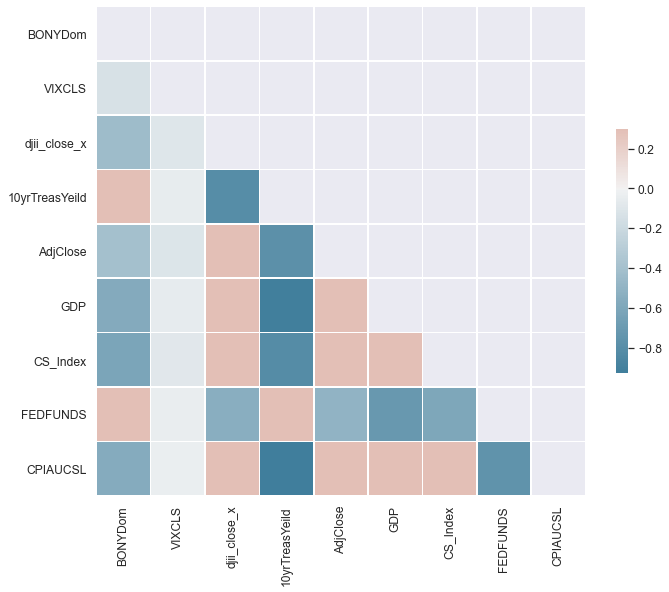

In [512]:
#BONYDom Correlation Matrix
BONYDomCorr2 = BONYDom2.corr()

# Generate a mask for the upper triangle
mask = np.triu(np.ones_like(BONYDomCorr2, dtype=bool))

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(11, 9))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(230, 20, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(BONYDomCorr2, mask=mask, cmap=cmap, vmax=.3, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

Pretty strong correlations across the board for BONY domestic deposits, with the exception of VIX. 

C:\Users\Cathy\anaconda3\lib\site-packages\seaborn\distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


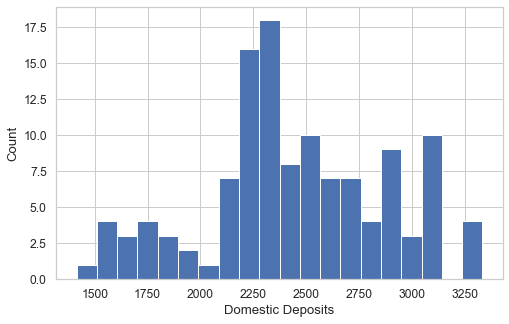

In [513]:
#Histogram of dependent variable to understand distribution: 
sns.set(style='whitegrid', palette="deep", font_scale=1.1, rc={"figure.figsize": [8, 5]})
sns.distplot(BONYDom2['BONYDom'], norm_hist=False, kde=False, bins=20, hist_kws={"alpha": 1}
).set(xlabel='Domestic Deposits', ylabel='Count');

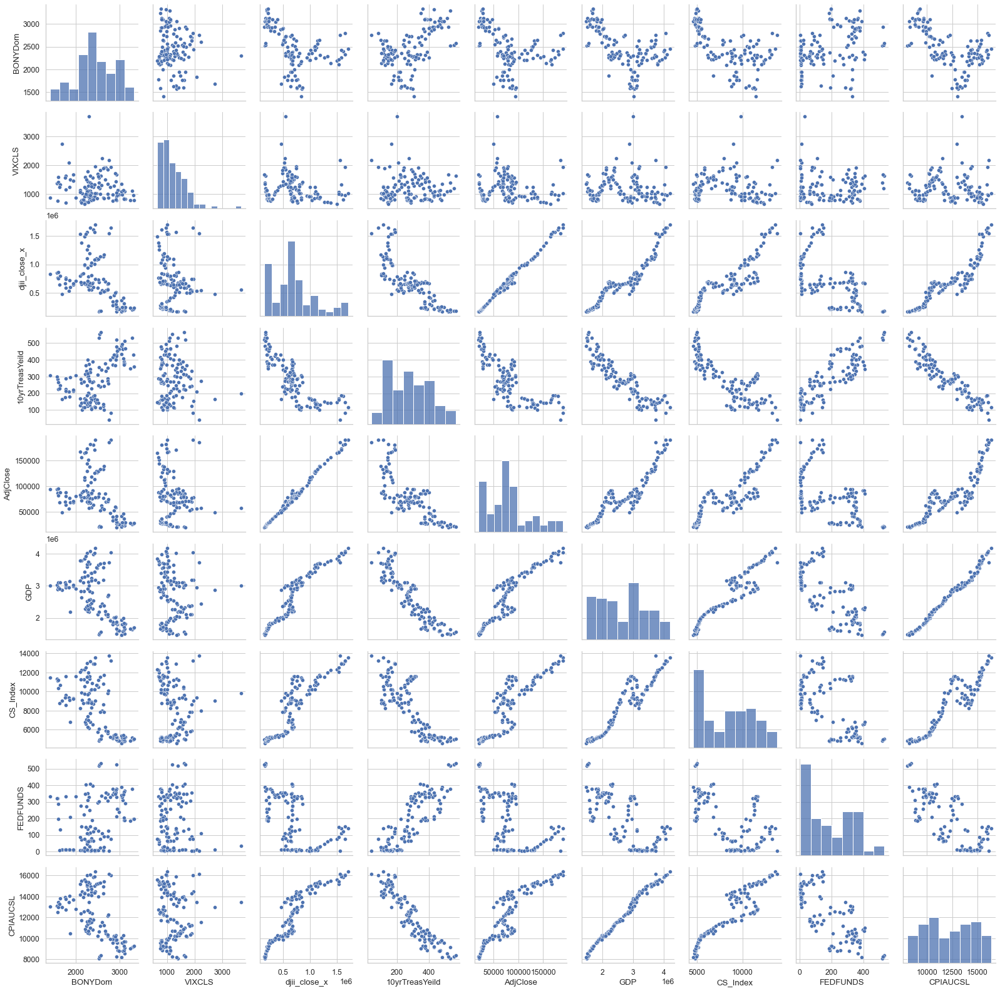

In [515]:
#Show univariate distribution of each variable
g = sns.PairGrid(BONYDom2)
g.map_diag(sns.histplot)
g.map_offdiag(sns.scatterplot)

<AxesSubplot:>

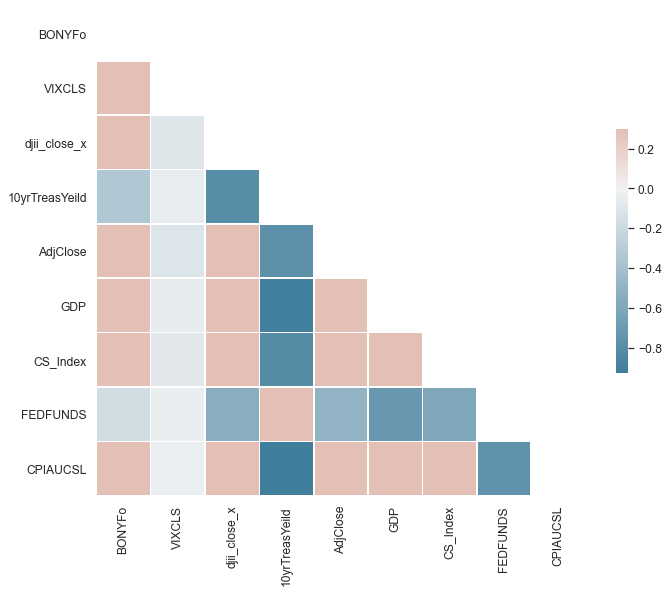

In [516]:
#BONYFo Correlation Matrix
BONYFoCorr2 = BONYFo2.corr()

# Generate a mask for the upper triangle
mask = np.triu(np.ones_like(BONYFoCorr2, dtype=bool))

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(11, 9))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(230, 20, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(BONYFoCorr2, mask=mask, cmap=cmap, vmax=.3, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

Similar to last set of results, negative correlation across the boad with our BONY Foreign Office deposits, we can keep with the same analysis using this quarterly data. 

C:\Users\Cathy\anaconda3\lib\site-packages\seaborn\distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


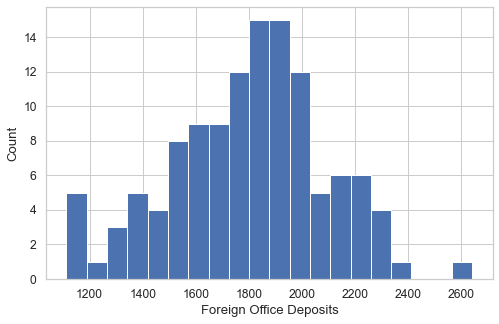

In [517]:
#Histogram of dependent variable to understand distribution: 
sns.set(style='whitegrid', palette="deep", font_scale=1.1, rc={"figure.figsize": [8, 5]})
sns.distplot(BONYFo2['BONYFo'], norm_hist=False, kde=False, bins=20, hist_kws={"alpha": 1}
).set(xlabel='Foreign Office Deposits', ylabel='Count');

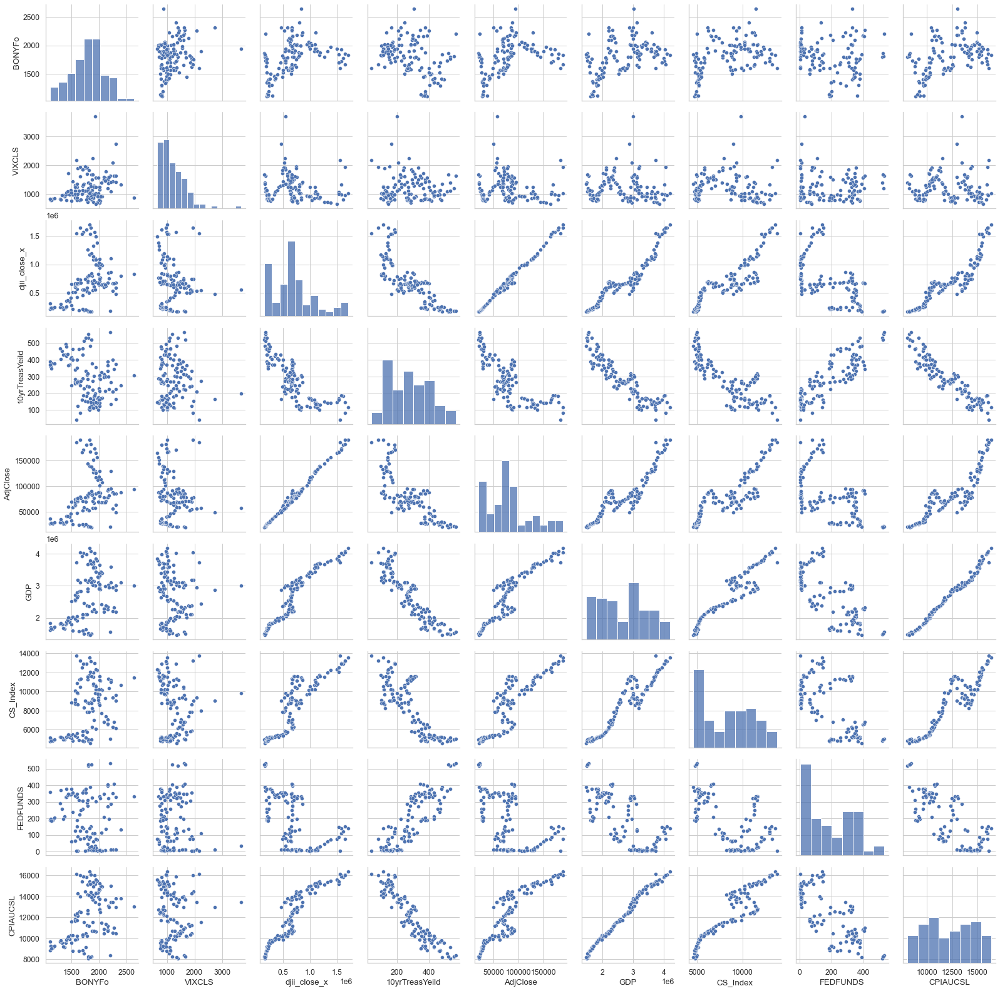

In [518]:
#Show univariate distribution of each variable
g = sns.PairGrid(BONYFo2)
g.map_diag(sns.histplot)
g.map_offdiag(sns.scatterplot)

<AxesSubplot:>

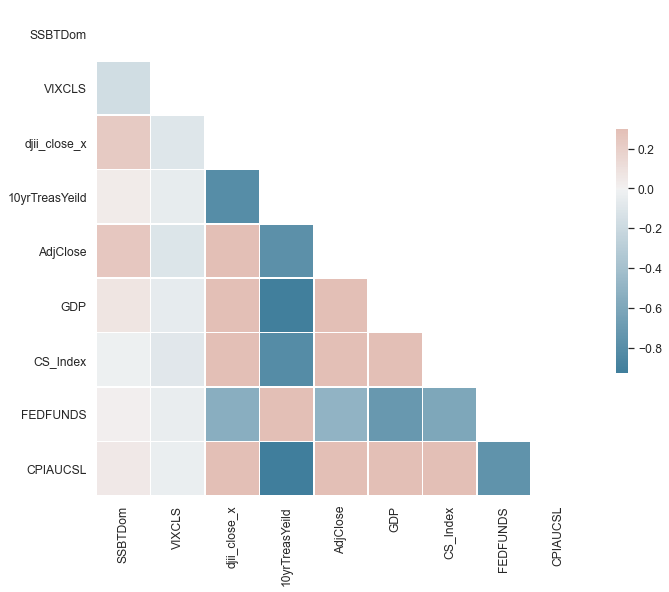

In [519]:
#SSBTDom Correlation Matrix
SSBTDomCorr2 = SSBTDom2.corr()

# Generate a mask for the upper triangle
mask = np.triu(np.ones_like(SSBTDomCorr2, dtype=bool))

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(11, 9))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(230, 20, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(SSBTDomCorr2, mask=mask, cmap=cmap, vmax=.3, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

Showing much weaker correlations with the quarterly adjusted data for SSB&T domestic - with only our stock indices close change being the strongest correlations.  

C:\Users\Cathy\anaconda3\lib\site-packages\seaborn\distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


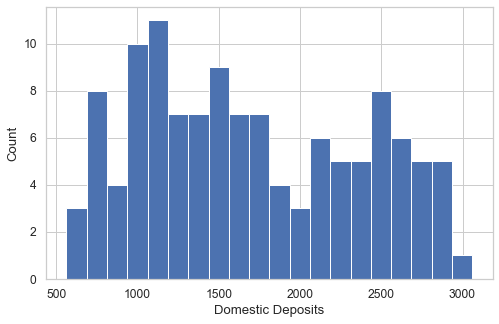

In [520]:
#Histogram of dependent variable to understand distribution: 
sns.set(style='whitegrid', palette="deep", font_scale=1.1, rc={"figure.figsize": [8, 5]})
sns.distplot(SSBTDom2['SSBTDom'], norm_hist=False, kde=False, bins=20, hist_kws={"alpha": 1}
).set(xlabel='Domestic Deposits', ylabel='Count');

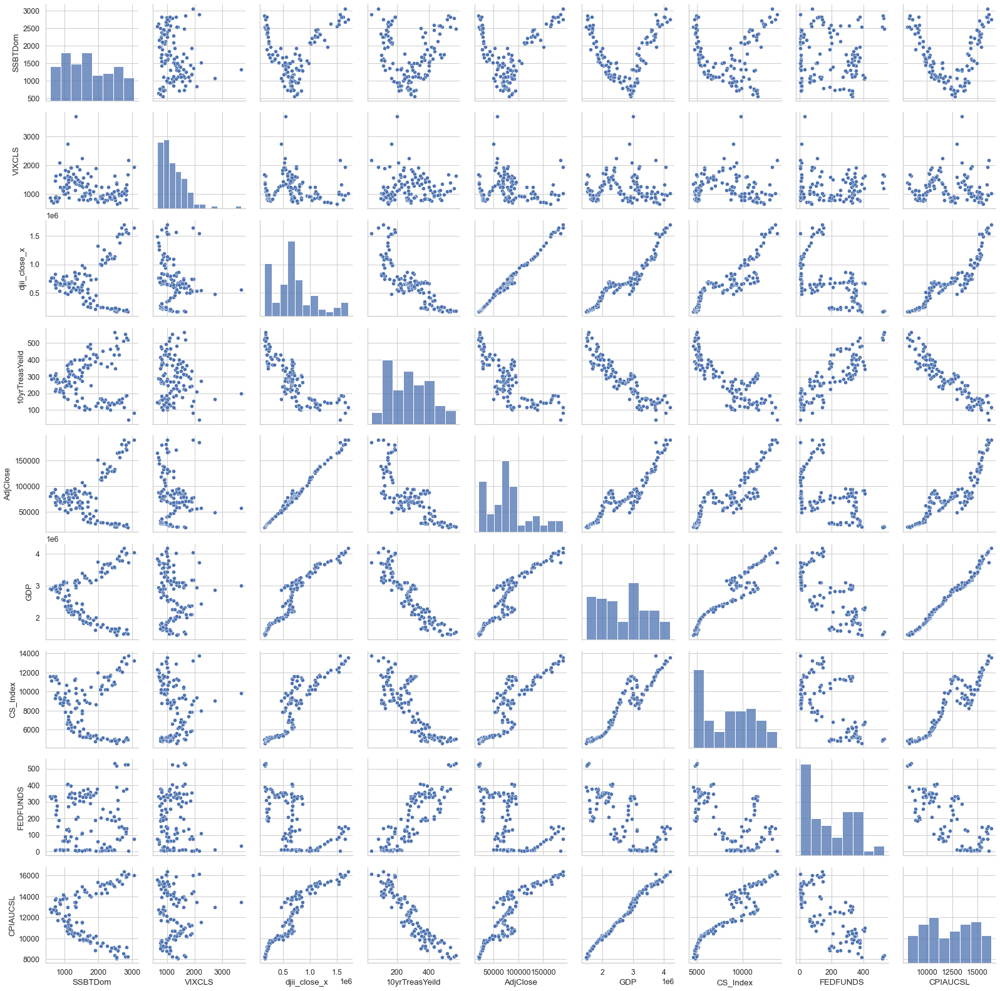

In [521]:
#Show univariate distribution of each variable
g = sns.PairGrid(SSBTDom2)
g.map_diag(sns.histplot)
g.map_offdiag(sns.scatterplot)

<AxesSubplot:>

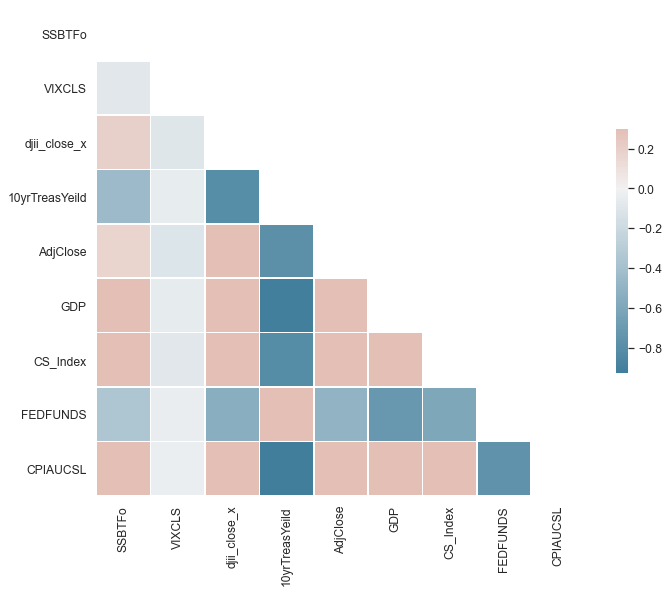

In [522]:
#SSBTFo Correlation Matrix
SSBTFoCorr2 = SSBTFo2.corr()

# Generate a mask for the upper triangle
mask = np.triu(np.ones_like(SSBTFoCorr2, dtype=bool))

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(11, 9))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(230, 20, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(SSBTFoCorr2, mask=mask, cmap=cmap, vmax=.3, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

C:\Users\Cathy\anaconda3\lib\site-packages\seaborn\distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


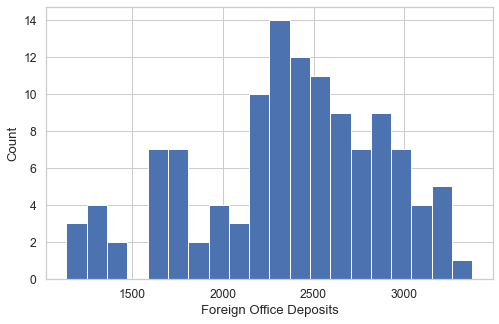

In [523]:
#Histogram of dependent variable to understand distribution: 
sns.set(style='whitegrid', palette="deep", font_scale=1.1, rc={"figure.figsize": [8, 5]})
sns.distplot(SSBTFo2['SSBTFo'], norm_hist=False, kde=False, bins=20, hist_kws={"alpha": 1}
).set(xlabel='Foreign Office Deposits', ylabel='Count');

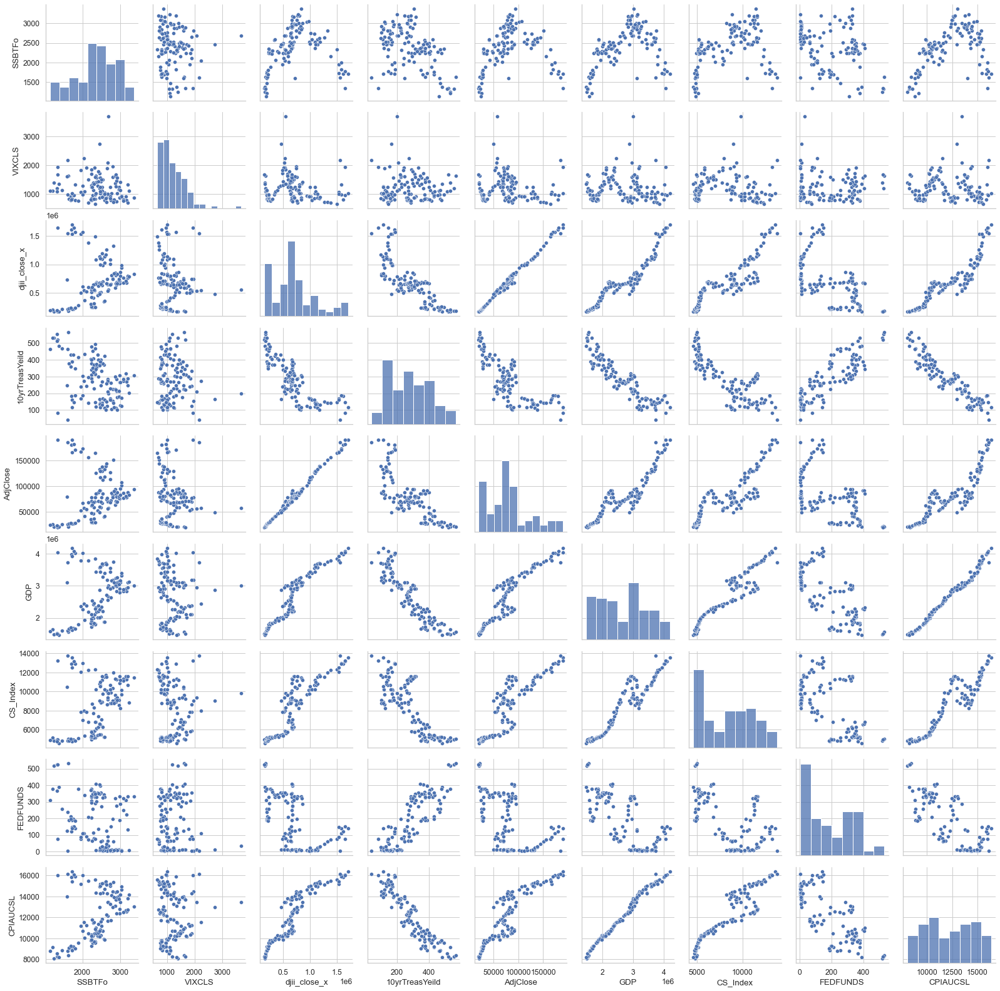

In [524]:
#Show univariate distribution of each variable
g = sns.PairGrid(SSBTFo2)
g.map_diag(sns.histplot)
g.map_offdiag(sns.scatterplot)

<AxesSubplot:>

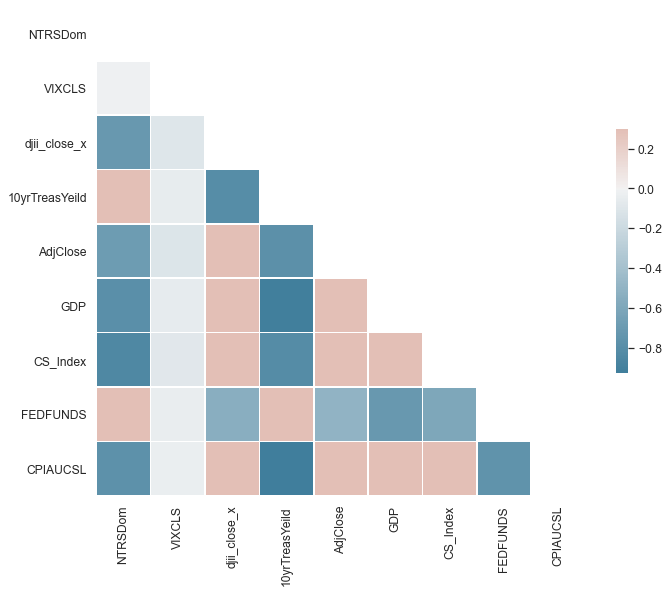

In [525]:
#NTRSDom Correlation Matrix
NTRSDomCorr2 = NTRSDom2.corr()

# Generate a mask for the upper triangle
mask = np.triu(np.ones_like(NTRSDomCorr2, dtype=bool))

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(11, 9))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(230, 20, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(NTRSDomCorr2, mask=mask, cmap=cmap, vmax=.3, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

Stronger correlations across the board for Domestic deposits with quarterly adjusted data, VIX still not a strong indicator.

C:\Users\Cathy\anaconda3\lib\site-packages\seaborn\distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


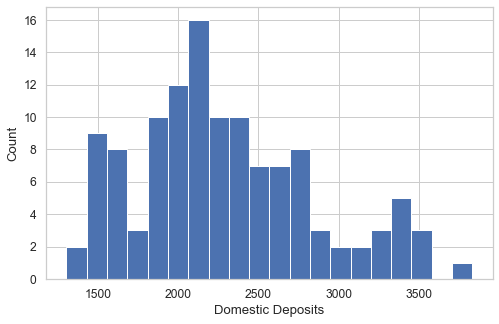

In [526]:
#Histogram of dependent variable to understand distribution: 
sns.set(style='whitegrid', palette="deep", font_scale=1.1, rc={"figure.figsize": [8, 5]})
sns.distplot(NTRSDom2['NTRSDom'], norm_hist=False, kde=False, bins=20, hist_kws={"alpha": 1}
).set(xlabel='Domestic Deposits', ylabel='Count');

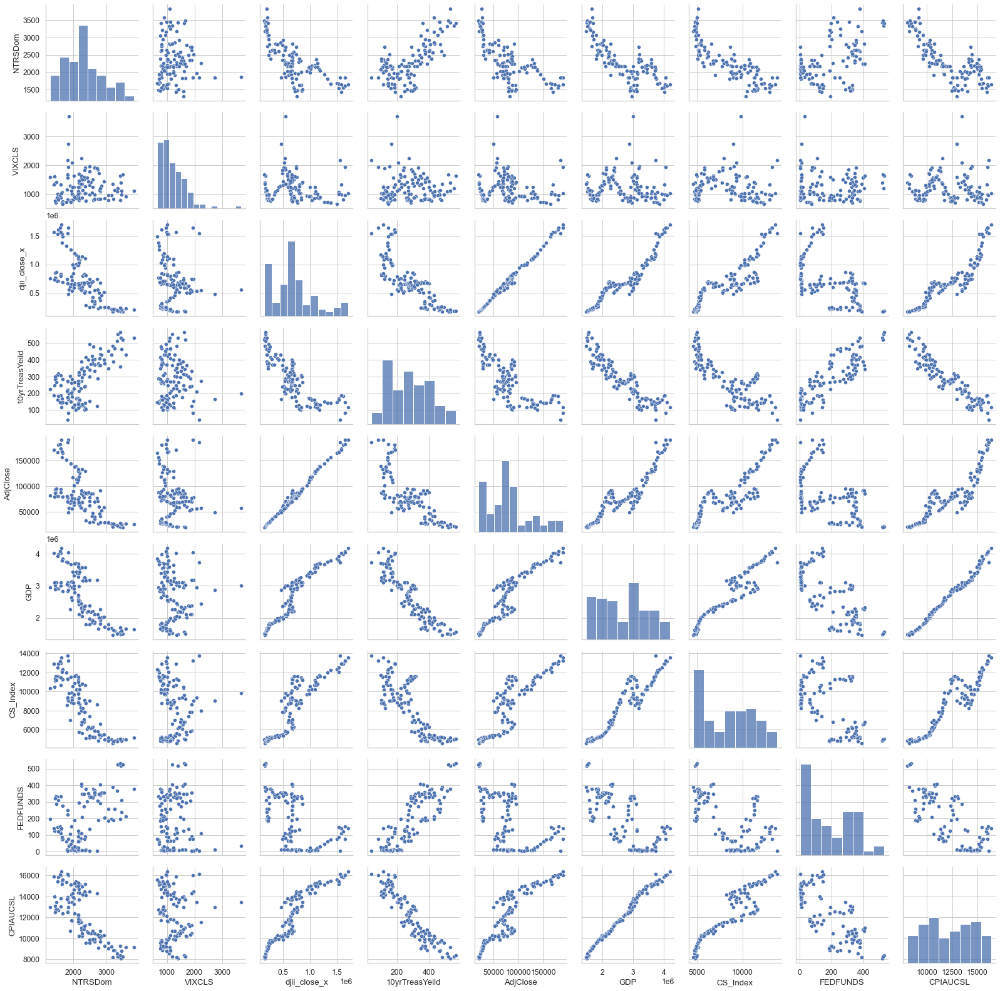

In [527]:
#Show univariate distribution of each variable
g = sns.PairGrid(NTRSDom2)
g.map_diag(sns.histplot)
g.map_offdiag(sns.scatterplot)

<AxesSubplot:>

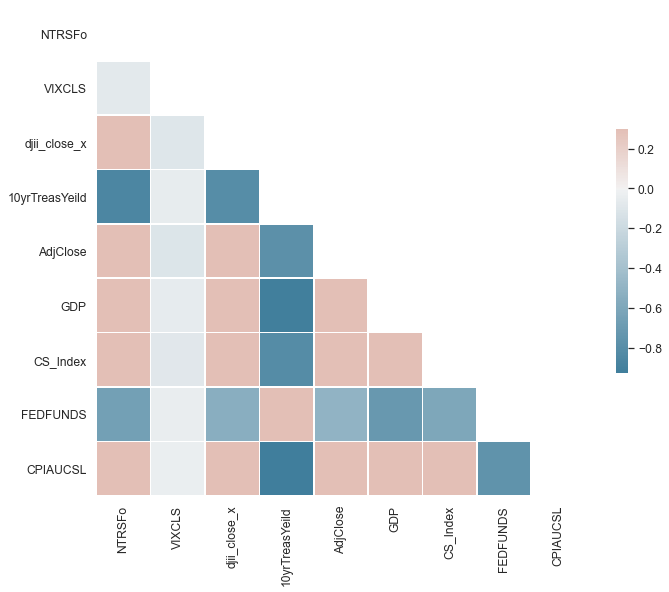

In [528]:
#NTRSFo Correlation Matrix
NTRSFoCorr2 = NTRSFo2.corr()

# Generate a mask for the upper triangle
mask = np.triu(np.ones_like(NTRSFoCorr2, dtype=bool))

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(11, 9))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(230, 20, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(NTRSFoCorr2, mask=mask, cmap=cmap, vmax=.3, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

Again stronger correlations with the quarterly data set, we will utilize all of our independent variables in our analysis on foreign office deposits. 

C:\Users\Cathy\anaconda3\lib\site-packages\seaborn\distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


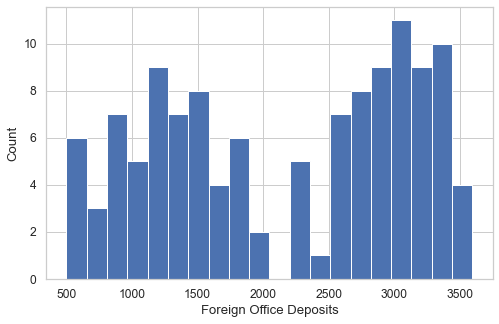

In [529]:
#Histogram of dependent variable to understand distribution: 
sns.set(style='whitegrid', palette="deep", font_scale=1.1, rc={"figure.figsize": [8, 5]})
sns.distplot(NTRSFo2['NTRSFo'], norm_hist=False, kde=False, bins=20, hist_kws={"alpha": 1}
).set(xlabel='Foreign Office Deposits', ylabel='Count');

Certainly a weirder distribution on this view, we will have to give this some more consideration in our choice of algorithm for forecasting. 

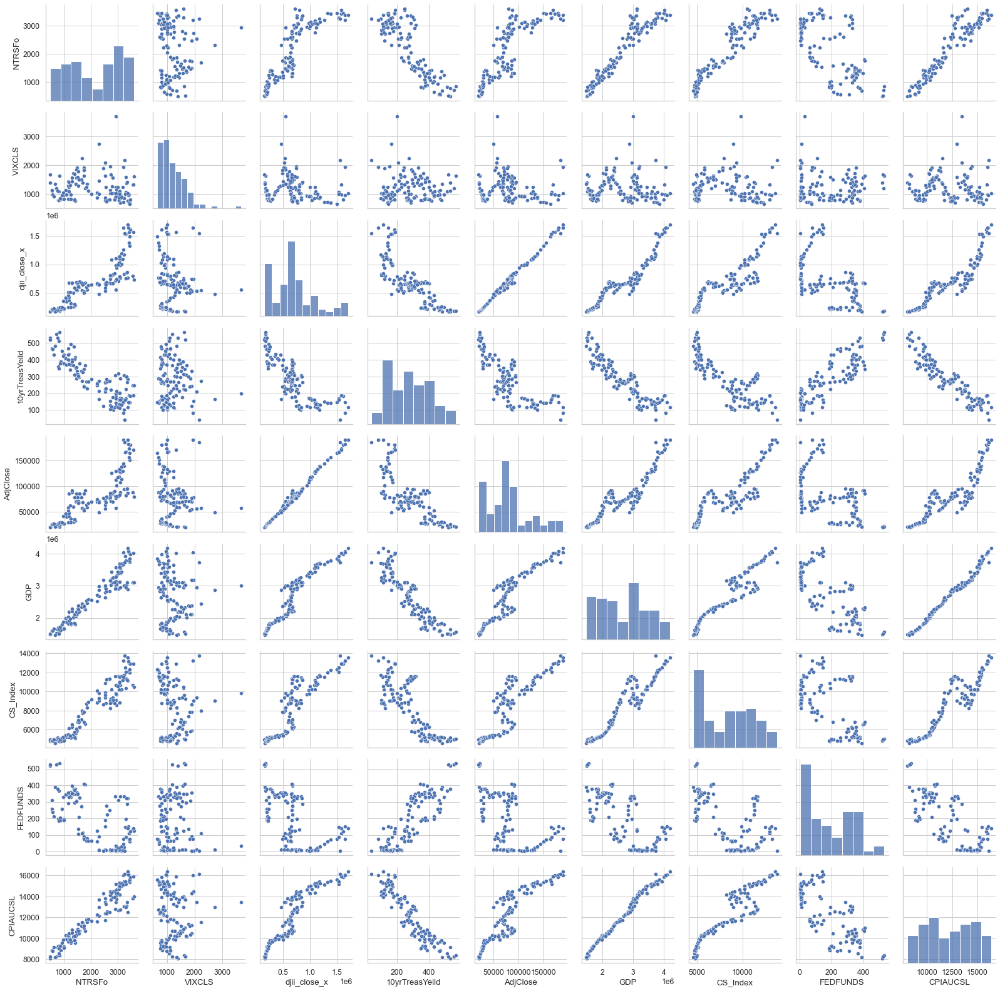

In [530]:
#Show univariate distribution of each variable
g = sns.PairGrid(NTRSFo2)
g.map_diag(sns.histplot)
g.map_offdiag(sns.scatterplot)

## A second view of quarterly deposits by bank: 

<AxesSubplot:>

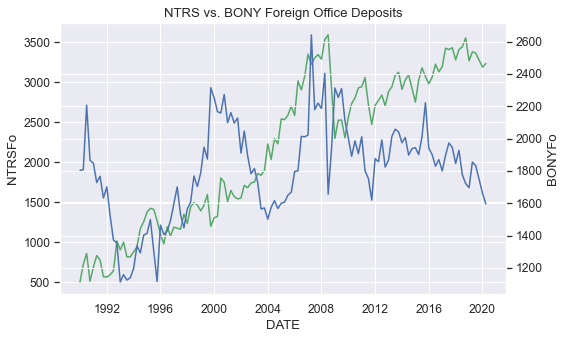

In [531]:
sns.set_style("darkgrid")
sns.lineplot(data = data2, x='DATE', y='NTRSFo', color = 'g').set_title('NTRS vs. BONY Foreign Office Deposits')
ax2 = plt.twinx()
sns.lineplot(data = data2, x = 'DATE', y = "BONYFo", color = 'b')
ax

<AxesSubplot:>

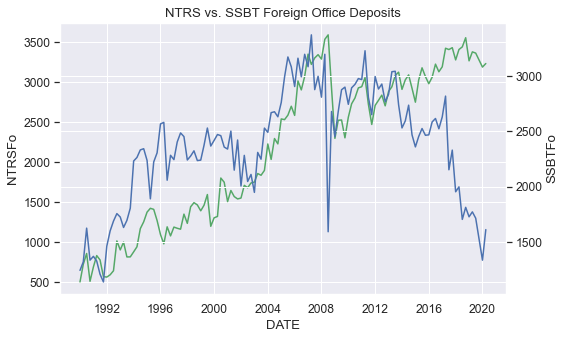

In [532]:
sns.set_style("darkgrid")
sns.lineplot(data = data2, x='DATE', y='NTRSFo', color = 'g').set_title('NTRS vs. SSBT Foreign Office Deposits')
ax2 = plt.twinx()
sns.lineplot(data = data2, x = 'DATE', y = "SSBTFo", color = 'b')
ax

<AxesSubplot:>

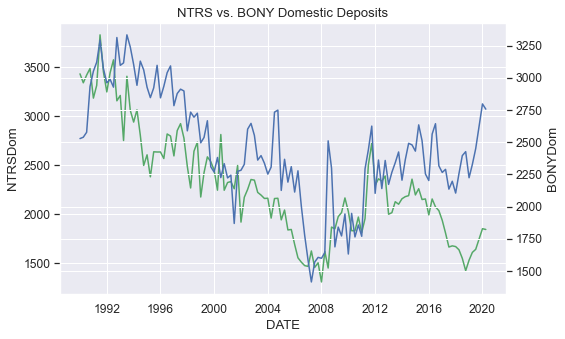

In [533]:
sns.set_style("darkgrid")
sns.lineplot(data = data2, x='DATE', y='NTRSDom', color = 'g').set_title('NTRS vs. BONY Domestic Deposits')
ax2 = plt.twinx()
sns.lineplot(data = data2, x = 'DATE', y = "BONYDom", color = 'b')
ax

<AxesSubplot:>

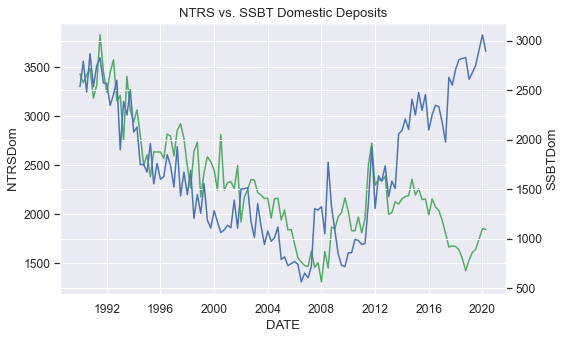

In [534]:
sns.set_style("darkgrid")
sns.lineplot(data = data2, x='DATE', y='NTRSDom', color = 'g').set_title('NTRS vs. SSBT Domestic Deposits')
ax2 = plt.twinx()
sns.lineplot(data = data2, x = 'DATE', y = "SSBTDom", color = 'b')
ax

## Thoughts dependent variable distributions and appropriate algorithm usage: 
A good deal of the dependent variables in our analysis would likely fall into the category where 75% of the data would fall within two standard deviations; or 89% falling within 3 standard deviations with the exception of the SSB&T FFP deposits.  Since these deposits are not necessarily and indicator of client behavior and are more structural in nature, it may make sense to strip the FFP & Repo from our analysis at this point.  

The non-linear nature of our data  application of the Chebyshev bound may be a good approach to the remainde of the analysis due to the factor that our data would not necessarily fall into a normal distribution[8], we could also consider leveraging the Chernoff Bound/Hoeffding Distribution for this analysis. 

Some other appraoches could be stick with using non-linear algorithms, including support vector regression, k-nearest neighbors and extra tree.  In addition to the non-linear we could also investigate performance on ensemble algorithms like Gradient Boosting Machines and Random Forest.

With some reading I feel like selecting a non-Linear regression tree using Scikit-learn would be a good appraoach for this time series forecasting exercise 

Subset names for each bank
BONYDom2
BONYFo2
SSBTDom2
SSBTFo2
NTRSDom2
NTRSFo2

In [754]:
import pandas as pd
import numpy as np
from sklearn import model_selection
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import Ridge
from sklearn.linear_model import Lasso
from sklearn.linear_model import ElasticNet
from sklearn.neighbors import KNeighborsRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.svm import SVR
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import r2_score
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
from math import sqrt
import matplotlib.pyplot as plt

### BONY Domestic Depoists Analysis: 

The first line of code creates an object of the target variable called 'target_column_BD'. The second line gives us the list of all the features, excluding the target variable 'BONYDom'.

We have seen above that the units of the variables differ significantly and may influence the modeling process. To prevent this, we will do normalization via scaling of the predictors between 0 and 1. The third line performs this task.

The fourth line displays the summary of the normalized data. We can see that all the independent variables have now been scaled between 0 and 1. The target variable remains unchanged. [8]

In [755]:
#Create arrays for features and response variables BONYDom2
target_col_BD = ['BONYDom']
predictorsBD = list(set(list(BONYDom2.columns))-set(target_col_BD))
BONYDom2[predictorsBD] = BONYDom2[predictorsBD]/BONYDom2[predictorsBD].max()
BONYDom2.describe()

C:\Users\Cathy\anaconda3\lib\site-packages\pandas\core\frame.py:3065: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[k1] = value[k2]


,BONYDom,VIXCLS,djii_close_x,10yrTreasYeild,AdjClose,GDP,CS_Index,FEDFUNDS,CPIAUCSL
count,121.000000,121.000000,121.000000,121.000000,121.000000,121.000000,121.000000,121.000000,121.000000
mean,2449.572810,0.330721,0.413270,0.497379,0.424960,0.637845,0.611513,0.342638,0.744428
std,433.294846,0.122931,0.226954,0.220384,0.227024,0.181524,0.197848,0.284318,0.144453
min,1414.350000,0.175744,0.094714,0.076668,0.106933,0.347178,0.333075,0.007167,0.490946
25%,2223.450000,0.240361,0.277185,0.298551,0.277131,0.477108,0.394429,0.044955,0.622626
50%,2395.260000,0.301200,0.389478,0.483921,0.406903,0.649284,0.637437,0.283952,0.746752
75%,2756.250000,0.388747,0.491825,0.662850,0.495272,0.761942,0.777249,0.619066,0.871968
max,3333.120000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


We will build our model on the training set and evaluate its performance on the test set. The first couple of lines of code below create arrays of the independent (X) and dependent (y) variables, respectively. The third line splits the data into training and test dataset, with the 'test_size' argument specifying the percentage of data to be kept in the test data. The fourth line prints the shape of the training set[11]

In [756]:
#Create Testng and Training Sets 
X_Bd = BONYDom2[predictorsBD].values
y_Bd = BONYDom2[target_col_BD].values

XBd_train, XBd_test, yBd_train, yBd_test = train_test_split(X, y, test_size=0.30, random_state=40)
print(XBd_train.shape); print(XBd_test.shape)

(85, 8)
(37, 8)


CART Feature Importance Analysis: 
We will first investigate feature importance for the CART models that will be leveraged for this analysis.   This analysis introduced by Jason Brownlee will be leveraged [12]

Feature: 0, Score: 0.57737
Feature: 1, Score: 0.10681
Feature: 2, Score: 0.05610
Feature: 3, Score: 0.02884
Feature: 4, Score: 0.13028
Feature: 5, Score: 0.02977
Feature: 6, Score: 0.04691
Feature: 7, Score: 0.02393


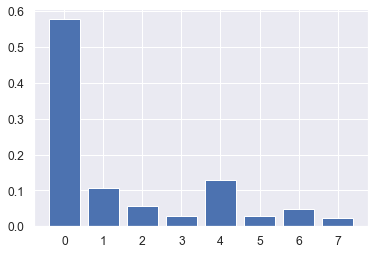

In [757]:
# decision tree for feature importance on a regression problem
from sklearn.datasets import make_regression
from sklearn.tree import DecisionTreeRegressor
from matplotlib import pyplot
# define the model
model = DecisionTreeRegressor()
# fit the model
model.fit(X_Bd, y_Bd)
# get importance
importance = model.feature_importances_
# summarize feature importance
for i,v in enumerate(importance):
    print('Feature: %0d, Score: %.5f' % (i,v))
# plot feature importance
pyplot.bar([x for x in range(len(importance))], importance)
pyplot.show()

We can conduct our analysis based on the feature importance, we can first run the model as is and make adjustments as we see fit.  We will start our model selection by viewing the performance of decision trees. I'm having a hard time accepting that Vix is that important to this model. 

In [758]:
dtreeBd = DecisionTreeRegressor(max_depth=8, min_samples_leaf=0.13, random_state=3)
dtreeBd.fit(XBd_train, yBd_train)

DecisionTreeRegressor(max_depth=8, min_samples_leaf=0.13, random_state=3)

Once the model is built on the training set, we can make the predictions. The first line of code below predicts on the training set. The second and third lines of code prints the evaluation metrics - RMSE and R-squared - on the training set. The same steps are repeated on the test dataset in the fourth to sixth lines.[10]

In [759]:
# Code lines 1 to 3
predBd_train_tree= dtreeBd.predict(XBd_train)
print(np.sqrt(mean_squared_error(yBd_train,predBd_train_tree)))
print(r2_score(yBd_train, predBd_train_tree))

# Code lines 4 to 6
predBd_test_tree= dtreeBd.predict(X_test)
print(np.sqrt(mean_squared_error(yBd_test,predBd_test_tree))) 
print(r2_score(yBd_test, predBd_test_tree))

352.3769348626779
0.7195813280207485
325.1653203258901
0.8008343879351728


The above output shows that the RMSE is 352.38 for train data and 325.17 for test data. On the other hand, the R-squared value is 72 percent for train data and 80 percent for test data. More improvement can be done by parameter tuning. We will be changing the values of the parameter, 'max_depth', to see how that affects the model performance[11].

The first four lines of code below instantiates and fits the regression trees with 'max_depth' parameter of 2 and 5, respectively. The fifth and sixth lines of code generate predictions on the training data, whereas the seventh and eight lines of code gives predictions on the testing data [11].

In [760]:
# Code Lines 1 to 4: Fit the regression tree 'dtree1' and 'dtree2' 
dtree1Bd = DecisionTreeRegressor(max_depth=2)
dtree2Bd = DecisionTreeRegressor(max_depth=5)
dtree1Bd.fit(XBd_train, yBd_train)
dtree2Bd.fit(XBd_train, yBd_train)

# Code Lines 5 to 6: Predict on training data
tr1Bd = dtree1Bd.predict(XBd_train)
tr2Bd = dtree2Bd.predict(XBd_train) 

#Code Lines 7 to 8: Predict on testing data
y1Bd = dtree1Bd.predict(X_test)
y2Bd = dtree2Bd.predict(X_test) 

Generate the evaluation metrics - RMSE and R-squared - for the first regression tree, 'dtree1Bd'.

In [761]:
# Print RMSE and R-squared value for regression tree 'dtree1' on training data
print(np.sqrt(mean_squared_error(yBd_train,tr1Bd))) 
print(r2_score(yBd_train, tr1Bd))

# Print RMSE and R-squared value for regression tree 'dtree1' on testing data
print(np.sqrt(mean_squared_error(yBd_test,y1Bd))) 
print(r2_score(yBd_test, y1Bd)) 

320.3787765982261
0.7681967832399745
451.40056644314825
0.6161777799793751


Not the best results when adjusting the max depth of our decision tree to 5, we will change our approach and try Random forest on the BONY domestic deposits to see if we get a better outcome of our model. 

The first line of code below instantiates the Random Forest Regression model with the 'n_estimators' value of 500. 'n_estimators' indicates the number of trees in the forest. The second line fits the model to the training data.

The third line of code predicts, while the fourth and fifth lines print the evaluation metrics - RMSE and R-squared - on the training set. The same steps are repeated on the test dataset in the sixth to eight lines of code.

In [762]:
#RF model
model_rf = RandomForestRegressor(n_estimators=500, oob_score=True, random_state=100)
model_rf.fit(XBd_train, yBd_train) 
pred_train_rf= model_rf.predict(XBd_train)
print(np.sqrt(mean_squared_error(yBd_train,pred_train_rf)))
print(r2_score(yBd_train, pred_train_rf))

pred_test_rf = model_rf.predict(XBd_test)
print(np.sqrt(mean_squared_error(y_test,pred_test_rf)))
print(r2_score(yBd_test, pred_test_rf))

<ipython-input-762-c59b6d800933>:3: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  model_rf.fit(XBd_train, yBd_train)


152.98442979784267
0.9471449551826304
251.97641436187226
0.8804015098988803


Overall our Random Forest Model yeilds better results, our RMSE and R-Squared values on the training data are 153, and 94.7% respectively.  For the test data our RMSE and R-Squared yeilds 252 and 88% respectively, much better results versus the decision trees used before - showing that it is a superior model as compared to decision trees for forecasting. 

Lets quickly see if by reducing the explanatory variables down to those with the highest feature scores yeilds even better results.  We will make a new subset of the BONY Domestic deposits, reducing it down to the features with the most importance from our earlier investigation of classification feature importnace and see how our peformance stacks up against our model.  

In [765]:
#Selecting 0,4,7 or  VIX, Dow Jones Close, GDP, and CPI
BONYDom3 = data2[['BONYDom','VIXCLS','djii_close_x','GDP','CPIAUCSL']]

In [768]:
#Create arrays for features and response variables BONYDom3
target_col_BD3 = ['BONYDom']
predictorsBD3 = list(set(list(BONYDom3.columns))-set(target_col_BD3))
BONYDom3[predictorsBD] = BONYDom2[predictorsBD]/BONYDom2[predictorsBD3].max()
BONYDom3.describe()

C:\Users\Cathy\anaconda3\lib\site-packages\pandas\core\frame.py:3065: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[k1] = value[k2]


,BONYDom,VIXCLS,djii_close_x,GDP,CPIAUCSL,CS_Index,FEDFUNDS,AdjClose,10yrTreasYeild
count,121.000000,121.000000,121.000000,121.000000,121.000000,121.000000,121.000000,121.000000,121.000000
mean,2449.572810,0.330721,0.413270,0.637845,0.744428,0.611513,0.342638,0.424960,0.497379
std,433.294846,0.122931,0.226954,0.181524,0.144453,0.197848,0.284318,0.227024,0.220384
min,1414.350000,0.175744,0.094714,0.347178,0.490946,0.333075,0.007167,0.106933,0.076668
25%,2223.450000,0.240361,0.277185,0.477108,0.622626,0.394429,0.044955,0.277131,0.298551
50%,2395.260000,0.301200,0.389478,0.649284,0.746752,0.637437,0.283952,0.406903,0.483921
75%,2756.250000,0.388747,0.491825,0.761942,0.871968,0.777249,0.619066,0.495272,0.662850
max,3333.120000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [769]:
#Create arrays for features and response variables BONYDom3
X_Bd3 = BONYDom3[predictorsBD].values
y_Bd3 = BONYDom3[target_col_BD].values

XBd3_train, XBd3_test, yBd3_train, yBd3_test = train_test_split(X, y, test_size=0.30, random_state=40)
print(XBd_train.shape); print(XBd_test.shape)

(85, 8)
(37, 8)


In [770]:
#RF model for BD3
model_rf.fit(XBd3_train, yBd3_train) 

<ipython-input-770-a02489cae867>:2: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  model_rf.fit(XBd3_train, yBd3_train)


RandomForestRegressor(n_estimators=500, oob_score=True, random_state=100)

In [771]:
#Create Testng and Training Sets 
X_Bd3 = BONYDom3[predictorsBD3].values
y_Bd3 = BONYDom3[target_col_BD3].values

XBd3_train, XBd3_test, yBd3_train, yBd3_test = train_test_split(X_Bd3,y_Bd3, test_size=0.30, random_state=40)
print(XBd3_train.shape); print(XBd3_test.shape)

(84, 8)
(37, 8)


In [772]:
Bd_pred_train_rf= model_rf.predict(XBd3_train)
print(np.sqrt(mean_squared_error(yBd3_train,Bd_pred_train_rf)))
print(r2_score(yBd3_train, Bd_pred_train_rf))

pred_test_rf = model_rf.predict(XBd3_test)
print(np.sqrt(mean_squared_error(y_test,pred_test_rf)))
print(r2_score(yBd3_test, pred_test_rf))

949.6407455604036
-4.23729289121969
773.0551528713428
-3.021423599783536


Reducing our features did not yeild better results, for BONY Domestic Deposits.  So now we can focus on our first Random Forest model and view performance metrics. 

In [773]:
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report

#Jupyter Notebook, include the following so that plots will display:
%matplotlib inline

In [774]:
#Running original RF Regressor model once more to put this at the top of the analysis 
model_rf.fit(XBd_train, yBd_train) 
pred_train_rf= model_rf.predict(XBd_train)
print(np.sqrt(mean_squared_error(yBd_train,pred_train_rf)))
print(r2_score(yBd_train, pred_train_rf))

pred_test_rf = model_rf.predict(XBd_test)
print(np.sqrt(mean_squared_error(y_test,pred_test_rf)))
print(r2_score(yBd_test, pred_test_rf))

<ipython-input-774-62e5c3a58e39>:2: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  model_rf.fit(XBd_train, yBd_train)


152.98442979784267
0.9471449551826304
251.97641436187226
0.8804015098988803


Our RMSE on the training set was 153mm with a R-Squared value is 95%, the best possible score is 1.0 or 100% so this model is a good one for BONY Domestic Deposits.  Below lets get a view of our precitions

In [775]:
#Prediction on the modle to pass xBd_Test to get output y_pred providing an array of real numbers corresponding to the input array
yBd_Pred = model_rf.predict(XBd_test)
yBd_Pred

array([2796.22182, 1074.41132, 1142.1948 , 1853.41094, 1619.87398,
        791.15904, 1261.86002, 1307.85174,  786.51278, 2382.74702,
       1250.01964, 2160.68926,  981.69028, 2116.07656, 1304.06752,
       1342.88782, 2321.8777 , 1464.80338, 1380.84728, 2249.20098,
        945.1171 , 2275.26932, 1427.47312, 2126.47228, 2746.34642,
       1622.73086, 1459.31594, 1041.80668, 2616.18516, 2518.08666,
       2219.74592,  801.82376,  843.39356, 1692.07608,  989.85428,
       1160.17382, 1133.38916])

In [776]:
mse = mean_squared_error(yBd_test, yBd_Pred)
rmse = np.sqrt(mse)
rmse

251.97641436187226

To visualize a single decision tree for the BONY Domestic deposit model we can select one tree and save the tree as an image using the script below: 

In [777]:
# Import tools needed for visualization
from sklearn.tree import export_graphviz
import pydot
# Pull out one tree from the forest
tree = model_rf.estimators_[5]
# Import tools needed for visualization
from sklearn.tree import export_graphviz
import pydot
# Pull out one tree from the forest
tree = model_rf.estimators_[5]
# Export the image to a dot file
export_graphviz(tree, out_file = 'tree.dot', feature_names = predictorsBD, rounded = True, precision = 1)
# Use dot file to create a graph
(graph, ) = pydot.graph_from_dot_file('tree.dot')
# Write graph to a png file
graph.write_png('tree.png')

In [778]:
#Use Pillow to show tree
from PIL import Image
im = Image.open('tree.png')
im.show()

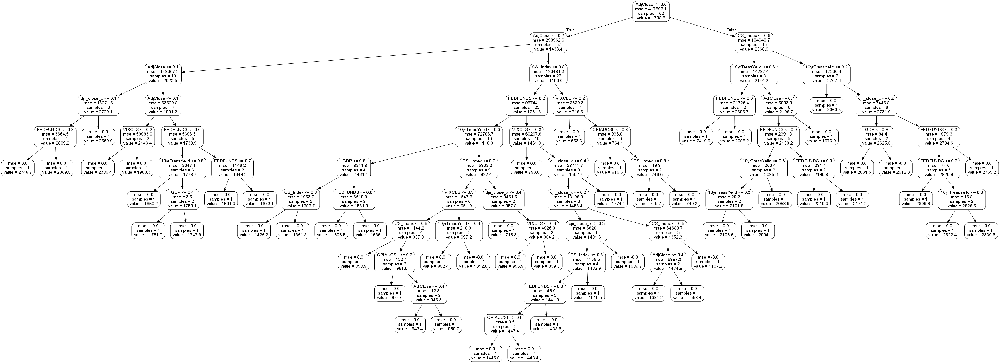

In [779]:
#Show tree in notebook 
from IPython.display import Image 
Image(filename = 'tree.png', width = 1000, height = 600)

### BONY Foreign Office Deposit Analysis: 
We will implement our random forest regression on the BONY Foreign Office deposits 

In [780]:
BONYFo.describe()

,BONYFo,VIXCLS,djii_close_x,10yrTreasYeild,TEDRATE,AdjClose,GDP,CS_Index,FEDFUNDS,CPIAUCSL,UNRATE
count,7624.000000,7688.000000,7688.000000,7688.000000,7688.000000,7688.000000,7687.000000,7687.000000,7688.000000,7688.000000,7688.000000
mean,28.603341,19.350245,11333.834412,4.437596,0.473772,1292.867095,42655.363471,134.353245,2.880723,194.345084,5.876730
std,4.861078,8.113370,6337.618220,1.989656,0.363798,703.350493,12330.988726,43.938104,2.371692,38.483583,1.723271
min,17.570000,0.000000,2365.100000,0.000000,0.000000,295.459991,23591.000000,75.138000,0.050000,127.500000,3.500000
25%,25.510000,13.580000,7440.505000,2.650000,0.230000,818.882507,31687.000000,85.869000,0.370000,160.400000,4.600000
50%,29.150000,17.295000,10538.835000,4.345000,0.390000,1199.789978,43265.000000,140.709000,2.400000,193.100000,5.500000
75%,31.920000,22.660000,13621.312500,5.960000,0.590000,1514.470032,51919.000000,172.017000,5.240000,231.221000,6.800000
max,41.930000,82.690000,29551.420000,9.090000,4.580000,3386.149902,66064.000000,219.873000,8.290000,259.050000,14.700000


In [781]:
BONYFo.head()

,DATE,BONYFo,VIXCLS,djii_close_x,10yrTreasYeild,TEDRATE,AdjClose,GDP,CS_Index,FEDFUNDS,CPIAUCSL,UNRATE
0,1990-01-01,28.62,17.24,2810.15,7.94,0.80,359.690002,23591.0,76.527,8.23,127.5,5.4
1,1990-01-02,28.62,17.24,2810.15,7.94,0.80,359.690002,23591.0,76.527,8.23,127.5,5.4
2,1990-01-03,28.62,18.19,2809.73,7.99,0.75,358.760010,23591.0,76.527,8.23,127.5,5.4
3,1990-01-04,28.62,19.22,2796.08,7.98,0.79,355.670013,23591.0,76.527,8.23,127.5,5.4
4,1990-01-05,28.62,20.11,2773.25,7.99,0.84,352.200012,23591.0,76.527,8.23,127.5,5.4


In [782]:
#Create arrays for features and response variables BONYFo
target_col_BF = ['BONYFo']
predictorsBF = list(set(list(BONYFo2.columns))-set(target_col_BF))
BONYFo2[predictorsBF] = BONYFo2[predictorsBF]/BONYFo2[predictorsBF].max()
BONYFo2.describe()

C:\Users\Cathy\anaconda3\lib\site-packages\pandas\core\frame.py:3065: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[k1] = value[k2]


,BONYFo,VIXCLS,djii_close_x,10yrTreasYeild,AdjClose,GDP,CS_Index,FEDFUNDS,CPIAUCSL
count,121.00000,121.000000,121.000000,121.000000,121.000000,121.000000,121.000000,121.000000,121.000000
mean,1802.24686,0.330721,0.413270,0.497379,0.424960,0.637845,0.611513,0.342638,0.744428
std,298.32716,0.122931,0.226954,0.220384,0.227024,0.181524,0.197848,0.284318,0.144453
min,1112.90000,0.175744,0.094714,0.076668,0.106933,0.347178,0.333075,0.007167,0.490946
25%,1606.40000,0.240361,0.277185,0.298551,0.277131,0.477108,0.394429,0.044955,0.622626
50%,1829.12000,0.301200,0.389478,0.483921,0.406903,0.649284,0.637437,0.283952,0.746752
75%,2003.24000,0.388747,0.491825,0.662850,0.495272,0.761942,0.777249,0.619066,0.871968
max,2641.59000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [783]:
#Create Testng and Training Sets BONY Foreign Office Deposits 
X_Bf = BONYFo2[predictorsBF].values
y_Bf = BONYFo2[target_col_BF].values

XBf_train, XBf_test, yBf_train, yBf_test = train_test_split(X_Bf, y_Bf, test_size=0.30, random_state=40)
print(XBf_train.shape); print(XBf_test.shape)

(84, 8)
(37, 8)


Feature: 0, Score: 0.43056
Feature: 1, Score: 0.12651
Feature: 2, Score: 0.15867
Feature: 3, Score: 0.13187
Feature: 4, Score: 0.00134
Feature: 5, Score: 0.05314
Feature: 6, Score: 0.07618
Feature: 7, Score: 0.02172


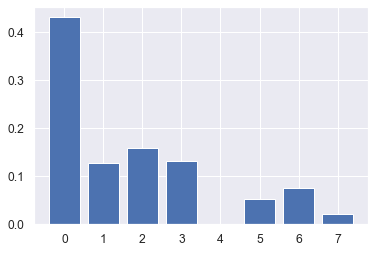

In [784]:
# decision tree for feature importance on a regression problem
from sklearn.datasets import make_regression
from sklearn.tree import DecisionTreeRegressor
from matplotlib import pyplot
# define the model
model = DecisionTreeRegressor()
# fit the model
model.fit(X_Bf, y_Bf)
# get importance
importance = model.feature_importances_
# summarize feature importance
for i,v in enumerate(importance):
    print('Feature: %0d, Score: %.5f' % (i,v))
# plot feature importance
pyplot.bar([x for x in range(len(importance))], importance)
pyplot.show()

In our BONY Foreign Office deposits we can see that our features play a more important role across the board, with the exception of 4 which is our S&P 500 Adjusted Close.  We will move forward with this analysis.

Now we can run our random forest regression.

In [785]:
#RF model
model_rf = RandomForestRegressor(n_estimators=500, oob_score=True, random_state=100)
model_rf.fit(XBf_train, yBf_train) 
pred_train_rf= model_rf.predict(XBf_train)
print(np.sqrt(mean_squared_error(yBf_train,pred_train_rf)))
print(r2_score(yBf_train, pred_train_rf))

pred_test_rf = model_rf.predict(XBf_test)
print(np.sqrt(mean_squared_error(y_test,pred_test_rf)))
print(r2_score(yBf_test, pred_test_rf))

<ipython-input-785-7708b5ff820b>:3: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  model_rf.fit(XBf_train, yBf_train)


52.50455109391167
0.9627240508192055
850.6903096009299
0.6868695471910368


Overall the RMSE and R-squared error for the training data is 53mm and 96%, and on the testing data we have slightly lower lesser accuracy in thatour RMSE is 851, and R-squared is 68%, lower than our domestic analysis. 

In [786]:
#Prediction on the modle to pass xBd_Test to get output y_pred providing an array of real numbers corresponding to the input array
yBf_Pred = model_rf.predict(XBf_test)
yBf_Pred

array([1855.74508, 2000.7369 , 1746.24962, 2052.73554, 1954.04134,
       1940.96362, 1642.2915 , 1913.41026, 1752.12364, 1889.25116,
       2070.94364, 1925.90782, 1891.41216, 1994.73078, 1872.1139 ,
       1197.46774, 1415.20886, 1967.25856, 2080.99538, 1254.96614,
       2014.38746, 1214.31276, 1800.84528, 1368.7186 , 2010.43324,
       1744.63604, 1908.38808, 2000.10264, 1873.93446, 2024.50898,
       1538.3146 , 1964.64614, 1669.01234, 2037.81596, 1849.69806,
       1915.56012, 1580.5321 ])

Given the fact that my main concern is forecasting NTRS deposits, I'm satisfied with this model we can move forward, for additional accuracy we could strip out the S&P 500 close from our analysis and see if results improve but BONY is not the most important factor in this analysis. 

To visualize a single decision tree for the BONY Foreign Office deposit model we can select one tree and save the tree as an image using the script below:

In [787]:
# Import tools needed for visualization
from sklearn.tree import export_graphviz
import pydot
# Pull out one tree from the forest
tree = model_rf.estimators_[5]
# Import tools needed for visualization
from sklearn.tree import export_graphviz
import pydot
# Pull out one tree from the forest
tree = model_rf.estimators_[5]
# Export the image to a dot file
export_graphviz(tree, out_file = 'tree.dot', feature_names = predictorsBD, rounded = True, precision = 1)
# Use dot file to create a graph
(graph, ) = pydot.graph_from_dot_file('tree.dot')
# Write graph to a png file
graph.write_png('tree.png')

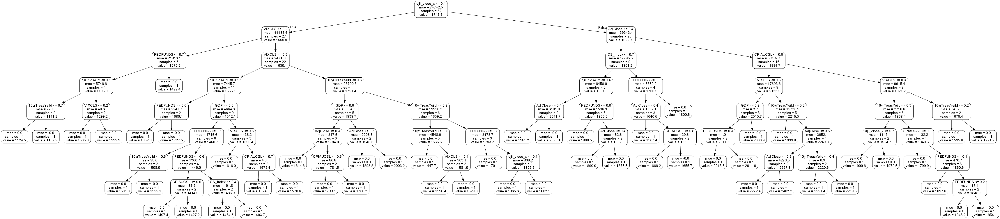

In [788]:
#Show tree in notebook 
from IPython.display import Image 
Image(filename = 'tree.png', width = 1000, height = 600)

### SSBT Domestic Deposits Analysis 

In [789]:
#Create arrays for features and response variables SSBTDom2
target_col_SD = ['SSBTDom']
predictorsSD = list(set(list(SSBTDom2.columns))-set(target_col_SD))
SSBTDom2[predictorsSD] = SSBTDom2[predictorsSD]/SSBTDom2[predictorsSD].max()
SSBTDom2.describe()

C:\Users\Cathy\anaconda3\lib\site-packages\pandas\core\frame.py:3065: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[k1] = value[k2]


,SSBTDom,VIXCLS,djii_close_x,10yrTreasYeild,AdjClose,GDP,CS_Index,FEDFUNDS,CPIAUCSL
count,121.000000,121.000000,121.000000,121.000000,121.000000,121.000000,121.000000,121.000000,121.000000
mean,1695.392893,0.330721,0.413270,0.497379,0.424960,0.637845,0.611513,0.342638,0.744428
std,674.358203,0.122931,0.226954,0.220384,0.227024,0.181524,0.197848,0.284318,0.144453
min,563.850000,0.175744,0.094714,0.076668,0.106933,0.347178,0.333075,0.007167,0.490946
25%,1111.320000,0.240361,0.277185,0.298551,0.277131,0.477108,0.394429,0.044955,0.622626
50%,1585.710000,0.301200,0.389478,0.483921,0.406903,0.649284,0.637437,0.283952,0.746752
75%,2296.960000,0.388747,0.491825,0.662850,0.495272,0.761942,0.777249,0.619066,0.871968
max,3060.320000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [790]:
#Create Testng and Training Sets SSBT Domestic 
X_SD = SSBTDom2[predictorsSD].values
y_SD = SSBTDom2[target_col_SD].values

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.30, random_state=40)
print(X_train.shape); print(X_test.shape)

(85, 8)
(37, 8)


Feature: 0, Score: 0.01141
Feature: 1, Score: 0.00594
Feature: 2, Score: 0.04635
Feature: 3, Score: 0.01968
Feature: 4, Score: 0.50512
Feature: 5, Score: 0.38849
Feature: 6, Score: 0.01910
Feature: 7, Score: 0.00391


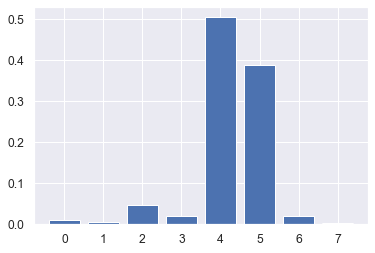

In [791]:
# decision tree for feature importance on a regression problem
from sklearn.datasets import make_regression
from sklearn.tree import DecisionTreeRegressor
from matplotlib import pyplot
# define the model
model = DecisionTreeRegressor()
# fit the model
model.fit(X_SD, y_SD)
# get importance
importance = model.feature_importances_
# summarize feature importance
for i,v in enumerate(importance):
    print('Feature: %0d, Score: %.5f' % (i,v))
# plot feature importance
pyplot.bar([x for x in range(len(importance))], importance)
pyplot.show()

For SSBT Domestic deposits it appears that we only have a couple of features within our model that are important, this would include VIX, 10 year Treasury Yeild (kind of), GDP, and Case Schiller Index. 

So we will narrow down our dataset to incorporate just these features for our analysis. 

In [792]:
#Selecting 0,4,7 or  VIX, 10 year Treasury Yeild (kind of), GDP, and Case Schiller Index
SSBTDom3 = data2[['SSBTDom','VIXCLS','10yrTreasYeild','GDP','CS_Index']]

In [793]:
#Create arrays for features and response variables SSBTDom3
target_col_SD3 = ['SSBTDom']
predictorsSD3 = list(set(list(SSBTDom3.columns))-set(target_col_SD3))
SSBTDom3[predictorsSD3] = SSBTDom3[predictorsSD3]/SSBTDom2[predictorsSD3].max()
SSBTDom3.describe()

C:\Users\Cathy\anaconda3\lib\site-packages\pandas\core\frame.py:3065: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[k1] = value[k2]


,SSBTDom,VIXCLS,10yrTreasYeild,GDP,CS_Index
count,121.000000,121.000000,121.000000,1.210000e+02,121.000000
mean,1695.392893,1222.062727,281.034215,2.674906e+06,8423.044719
std,674.358203,454.249245,124.523435,7.612491e+05,2725.179680
min,563.850000,649.400000,43.320000,1.455948e+06,4587.805000
25%,1111.320000,888.170000,168.690000,2.000832e+06,5432.907000
50%,1585.710000,1112.980000,273.430000,2.722880e+06,8780.130000
75%,2296.960000,1436.480000,374.530000,3.195328e+06,10705.907000
max,3060.320000,3695.150000,565.030000,4.193664e+06,13774.105000


In [794]:
#Create Testng and Training Sets SSSBT Domestic 
X_SD3 = SSBTDom3[predictorsSD3].values
y_SD3 = SSBTDom3[target_col_SD3].values

XSD3_train, XSD3_test, ySD3_train, ySD3_test = train_test_split(X_SD3, y_SD3, test_size=0.30, random_state=40)
print(XSD3_train.shape); print(XSD3_test.shape)

(84, 4)
(37, 4)


In [795]:
#RF model
model_rf = RandomForestRegressor(n_estimators=500, oob_score=True, random_state=100)
model_rf.fit(XSD3_train, ySD3_train) 
pred_train_rf= model_rf.predict(XSD3_train)
print(np.sqrt(mean_squared_error(yBf_train,pred_train_rf)))
print(r2_score(ySD3_train, pred_train_rf))

pred_test_rf = model_rf.predict(XSD3_test)
print(np.sqrt(mean_squared_error(ySD3_test,pred_test_rf)))
print(r2_score(ySD3_test, pred_test_rf))

<ipython-input-795-8f5c34f2b1ea>:3: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  model_rf.fit(XSD3_train, ySD3_train)


760.6899990718808
0.9830413701649962
247.19646560826934
0.8543208565548512


Our model yeilded more optimal results with 760mm MSE and 98% on our RMSE on our training data, testing a 247mm MSE and 85% R-Squared, telling us that our subsetted data did a good job of predicting SSBT Domestic Deposits.  

Now we can get a view of our predcitions below:

In [796]:
#Prediction on the modle to pass xSD_Test to get output y_pred providing an array of real numbers corresponding to the input array
ySD3_Pred = model_rf.predict(XSD3_test)
ySD3_Pred

array([2725.20618, 2317.2558 , 1080.8935 , 1464.74476, 1058.01154,
       1220.91656, 2198.83586, 1613.47222,  770.89718, 1659.92918,
       1444.81192,  799.51192, 2327.42966, 1486.37972, 1312.19232,
       2232.34652, 1853.52418, 1030.84562, 1308.5592 , 2359.51336,
        929.47758, 2311.12072, 2733.49234, 1627.54706, 2108.98652,
       2521.93688, 2614.40038,  927.28176, 1354.13882, 2245.05766,
       1725.12512, 2166.62832,  878.66586,  779.02776, 1181.07478,
       1200.92862, 1541.87784])

Now we can get a view of our trees: 

In [797]:
# Pull out one tree from the forest
tree = model_rf.estimators_[5]
# Import tools needed for visualization
from sklearn.tree import export_graphviz
import pydot
# Pull out one tree from the forest
tree = model_rf.estimators_[5]
# Export the image to a dot file
export_graphviz(tree, out_file = 'tree.dot', feature_names = predictorsSD3, rounded = True, precision = 1)
# Use dot file to create a graph
(graph, ) = pydot.graph_from_dot_file('tree.dot')
# Write graph to a png file
graph.write_png('tree.png')

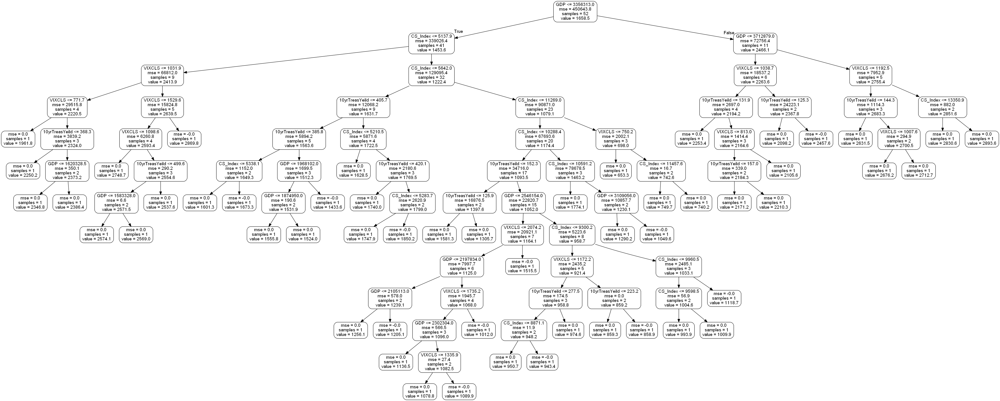

In [798]:
#Show tree in notebook 
from IPython.display import Image 
Image(filename = 'tree.png', width = 1000, height = 600)

### SSBT Foreign Office Deposit Analysis: 

In [799]:
#Create arrays for features and response variables SSBTFo
target_col_SF = ['SSBTFo']
predictorsSF = list(set(list(SSBTFo2.columns))-set(target_col_SF))
SSBTFo2[predictorsSF] = SSBTFo2[predictorsSF]/SSBTFo2[predictorsSF].max()
SSBTFo2.describe()

C:\Users\Cathy\anaconda3\lib\site-packages\pandas\core\frame.py:3065: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[k1] = value[k2]


,SSBTFo,VIXCLS,djii_close_x,10yrTreasYeild,AdjClose,GDP,CS_Index,FEDFUNDS,CPIAUCSL
count,121.000000,121.000000,121.000000,121.000000,121.000000,121.000000,121.000000,121.000000,121.000000
mean,2369.820331,0.330721,0.413270,0.497379,0.424960,0.637845,0.611513,0.342638,0.744428
std,516.192468,0.122931,0.226954,0.220384,0.227024,0.181524,0.197848,0.284318,0.144453
min,1139.840000,0.175744,0.094714,0.076668,0.106933,0.347178,0.333075,0.007167,0.490946
25%,2059.520000,0.240361,0.277185,0.298551,0.277131,0.477108,0.394429,0.044955,0.622626
50%,2452.810000,0.301200,0.389478,0.483921,0.406903,0.649284,0.637437,0.283952,0.746752
75%,2745.610000,0.388747,0.491825,0.662850,0.495272,0.761942,0.777249,0.619066,0.871968
max,3373.650000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [800]:
#Create Testng and Training Sets SSBT Foreign Office Deposits 
X_Sf = SSBTFo2[predictorsSF].values
y_Sf = SSBTFo2[target_col_SF].values

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.30, random_state=40)
print(X_train.shape); print(X_test.shape)

(85, 8)
(37, 8)


Feature: 0, Score: 0.04575
Feature: 1, Score: 0.03189
Feature: 2, Score: 0.00222
Feature: 3, Score: 0.06928
Feature: 4, Score: 0.16093
Feature: 5, Score: 0.01221
Feature: 6, Score: 0.00834
Feature: 7, Score: 0.66939


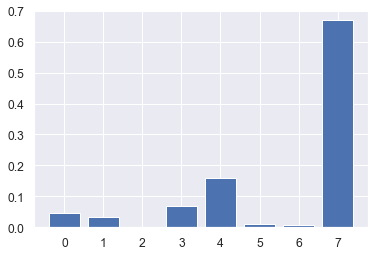

In [801]:
# decision tree for feature importance on a regression problem
from sklearn.datasets import make_regression
from sklearn.tree import DecisionTreeRegressor
from matplotlib import pyplot
# define the model
model = DecisionTreeRegressor()
# fit the model
model.fit(X_Sf, y_Sf)
# get importance
importance = model.feature_importances_
# summarize feature importance
for i,v in enumerate(importance):
    print('Feature: %0d, Score: %.5f' % (i,v))
# plot feature importance
pyplot.bar([x for x in range(len(importance))], importance)
pyplot.show()

On our SSBT Foreign Office Deposits, features 3,4,5, and 7 have the most importance this is: TEDRATE, AdjClose, and GDP we can adjust our data frame to include just those predictors: AdjClose, GDP, CS_Index, CPIAUCSL

In [802]:
SSBTFo3 = SSBTFo2[['SSBTFo','AdjClose','GDP','CS_Index','CPIAUCSL']] 

In [803]:
#Create arrays for features and response variables SSBTFo
target_col_SF3 = ['SSBTFo']
predictorsSF3 = list(set(list(SSBTFo3.columns))-set(target_col_SF3))
SSBTFo3[predictorsSF3] = SSBTFo3[predictorsSF3]/SSBTFo3[predictorsSF3].max()
SSBTFo3.describe()

C:\Users\Cathy\anaconda3\lib\site-packages\pandas\core\frame.py:3065: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[k1] = value[k2]


,SSBTFo,AdjClose,GDP,CS_Index,CPIAUCSL
count,121.000000,121.000000,121.000000,121.000000,121.000000
mean,2369.820331,0.424960,0.637845,0.611513,0.744428
std,516.192468,0.227024,0.181524,0.197848,0.144453
min,1139.840000,0.106933,0.347178,0.333075,0.490946
25%,2059.520000,0.277131,0.477108,0.394429,0.622626
50%,2452.810000,0.406903,0.649284,0.637437,0.746752
75%,2745.610000,0.495272,0.761942,0.777249,0.871968
max,3373.650000,1.000000,1.000000,1.000000,1.000000


In [804]:
#Create Testng and Training Sets 
X_Sf3 = SSBTFo3[predictorsSF3].values
y_Sf3 = SSBTFo3[target_col_SF3].values

X_trainSF3, X_testSF3, y_trainSF3, y_testSF3 = train_test_split(X_Sf3, y_Sf3, test_size=0.30, random_state=40)
print(X_trainSF3.shape); print(X_testSF3.shape)

(84, 4)
(37, 4)


In [805]:
#RF model
model_rf = RandomForestRegressor(n_estimators=500, oob_score=True, random_state=100)
model_rf.fit(X_trainSF3, y_trainSF3) 
pred_train_rf= model_rf.predict(X_trainSF3)
print(np.sqrt(mean_squared_error(y_trainSF3,pred_train_rf)))
print(r2_score(y_trainSF3, pred_train_rf))

pred_test_rf = model_rf.predict(X_testSF3)
print(np.sqrt(mean_squared_error(y_testSF3,pred_test_rf)))
print(r2_score(y_testSF3, pred_test_rf))

<ipython-input-805-24776fdc6f12>:3: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  model_rf.fit(X_trainSF3, y_trainSF3)


95.67554805755088
0.9672654385018015
215.5266504448248
0.7949355502552964


Our RMSE & R-Squared for the testing and training set fall within a resonable level of tolerance. Now we can get a look at our predcitions. 

In [806]:
#Prediction on the modle to pass xSD_Test to get output y_pred providing an array of real numbers corresponding to the input array
ySF3_Pred = model_rf.predict(X_testSF3)
ySF3_Pred

array([1954.9097 , 2523.66942, 2539.21258, 2366.583  , 2718.05416,
       2271.97764, 1813.14598, 2966.95438, 2879.80158, 2954.74316,
       2356.91064, 3096.84176, 2560.96318, 2332.76638, 2893.8963 ,
       1667.68438, 2186.27136, 2898.5099 , 2409.77174, 1693.4787 ,
       2799.13504, 1735.27864, 1302.34408, 2292.9874 , 2643.79856,
       1299.18322, 2010.32188, 2879.39446, 2876.47734, 2574.8971 ,
       2291.87308, 2587.47886, 2864.08022, 2941.1397 , 2054.1303 ,
       2333.74978, 2361.92082])

### Northern Trust Domestic Deposit Analysis

We will go a little further in depth with this analysis as we'd like to apply this at some level to forecast deposit movement. 

In [807]:
#Create arrays for features and response variables NTRNDom2
target_col_ND = ['NTRSDom']
predictorsND = list(set(list(NTRSDom2.columns))-set(target_col_ND))
NTRSDom2[predictorsND] = NTRSDom2[predictorsND]/NTRSDom2[predictorsND].max()
NTRSDom2.describe()

C:\Users\Cathy\anaconda3\lib\site-packages\pandas\core\frame.py:3065: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[k1] = value[k2]


,NTRSDom,VIXCLS,djii_close_x,10yrTreasYeild,AdjClose,GDP,CS_Index,FEDFUNDS,CPIAUCSL,Predictions
count,121.000000,121.000000,121.000000,121.000000,121.000000,121.000000,121.000000,121.000000,121.000000,121.000000
mean,0.599571,0.330721,0.413270,0.497379,0.424960,0.637845,0.611513,0.342638,0.744428,0.651445
std,0.146386,0.122931,0.226954,0.220384,0.227024,0.181524,0.197848,0.284318,0.144453,0.153758
min,0.340563,0.175744,0.094714,0.076668,0.106933,0.347178,0.333075,0.007167,0.490946,0.420650
25%,0.500278,0.240361,0.277185,0.298551,0.277131,0.477108,0.394429,0.044955,0.622626,0.546815
50%,0.572366,0.301200,0.389478,0.483921,0.406903,0.649284,0.637437,0.283952,0.746752,0.621992
75%,0.687350,0.388747,0.491825,0.662850,0.495272,0.761942,0.777249,0.619066,0.871968,0.741795
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [808]:
#Create Testng and Training Sets NTRS Domestic 
X_ND = NTRSDom2[predictorsND].values
y_ND = NTRSDom2[target_col_ND].values

X_ND_train, X_ND_test, y_ND_train, y_ND_test = train_test_split(X_ND, y_ND, test_size=0.30, random_state=40)
print(X_ND_train.shape); print(X_ND_test.shape)

(84, 9)
(37, 9)


Feature: 0, Score: 0.01626
Feature: 1, Score: 0.01173
Feature: 2, Score: 0.00588
Feature: 3, Score: 0.00582
Feature: 4, Score: 0.00584
Feature: 5, Score: 0.00088
Feature: 6, Score: 0.94303
Feature: 7, Score: 0.00371
Feature: 8, Score: 0.00686


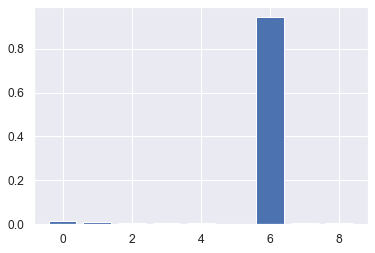

In [809]:
# decision tree for feature importance on a regression problem
from sklearn.datasets import make_regression
from sklearn.tree import DecisionTreeRegressor
from matplotlib import pyplot
# define the model
model = DecisionTreeRegressor()
# fit the model
model.fit(X_ND, y_ND)
# get importance
importance = model.feature_importances_
# summarize feature importance
for i,v in enumerate(importance):
    print('Feature: %0d, Score: %.5f' % (i,v))
# plot feature importance
pyplot.bar([x for x in range(len(importance))], importance)
pyplot.show()

It will always surprise me the correlation between VIX and deposits, obviously for NTRS Domestic deposits this plays an important factor.  In addition 10-year treasury yield, and CPI.  Since there are only three indicators we can run the model as a whole and once more with these features only and see if we yield better results. 

In [810]:
#RF model
model_rf = RandomForestRegressor(n_estimators=500, oob_score=True, random_state=100)
model_rf.fit(X_ND_train, y_ND_train) 
pred_train_rf= model_rf.predict(X_ND_train)
print(np.sqrt(mean_squared_error(y_ND_train,pred_train_rf)))
print(r2_score(y_ND_train, pred_train_rf))

pred_test_rf = model_rf.predict(X_ND_test)
print(np.sqrt(mean_squared_error(y_ND_test,pred_test_rf)))
print(r2_score(y_ND_test, pred_test_rf))

<ipython-input-810-ec5bcd42983c>:3: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  model_rf.fit(X_ND_train, y_ND_train)


0.007814676822080646
0.9970454880198751
0.07219543467402222
0.763480604798354


Our RMSE & R-Squared for the testing and training set fall within a resonable level of tolerance, 0.009, and 98% and 267mm 0.78. Let's see if adjusting our features to align with our feature importance analysis will improve the peformance of the model.

In [811]:
NTRSDom3 = NTRSDom2[['NTRSDom','VIXCLS','10yrTreasYeild','CPIAUCSL']] 

In [812]:
#Create arrays for features and response variables NTRNDom2
target_col_ND3 = ['NTRSDom']
predictorsND3 = list(set(list(NTRSDom3.columns))-set(target_col_ND3))
NTRSDom3[predictorsND3] = NTRSDom3[predictorsND3]/NTRSDom3[predictorsND3].max()
NTRSDom3.describe()

C:\Users\Cathy\anaconda3\lib\site-packages\pandas\core\frame.py:3065: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[k1] = value[k2]


,NTRSDom,VIXCLS,10yrTreasYeild,CPIAUCSL
count,121.000000,121.000000,121.000000,121.000000
mean,0.599571,0.330721,0.497379,0.744428
std,0.146386,0.122931,0.220384,0.144453
min,0.340563,0.175744,0.076668,0.490946
25%,0.500278,0.240361,0.298551,0.622626
50%,0.572366,0.301200,0.483921,0.746752
75%,0.687350,0.388747,0.662850,0.871968
max,1.000000,1.000000,1.000000,1.000000


In [813]:
#Create Testng and Training Sets NTRS3 Domestic 
X_ND3 = NTRSDom3[predictorsND3].values
y_ND3 = NTRSDom3[target_col_ND3].values

X_ND3_train, X_ND3_test, y_ND3_train, y_ND3_test = train_test_split(X_ND3, y_ND3, test_size=0.30, random_state=40)
print(X_ND3_train.shape); print(X_ND3_test.shape)

(84, 3)
(37, 3)


In [814]:
#RF model
model_rf = RandomForestRegressor(n_estimators=500, oob_score=True, random_state=100)
model_rf.fit(X_ND3_train, y_ND3_train) 
pred_train_rf= model_rf.predict(X_ND3_train)
print(np.sqrt(mean_squared_error(y_ND3_train,pred_train_rf)))
print(r2_score(y_ND3_train, pred_train_rf))

pred_test_rf = model_rf.predict(X_ND3_test)
print(np.sqrt(mean_squared_error(y_ND3_test,pred_test_rf)))
print(r2_score(y_ND3_test, pred_test_rf))

<ipython-input-814-dccf4de18514>:3: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  model_rf.fit(X_ND3_train, y_ND3_train)


0.02018748587284753
0.9802835744996476
0.07159663561466365
0.7673877840390306


Ok on our testing and training we have 77mm RMSE and 0.98 on our R-Squared which is very good, our predictions we have 0.02mm RMSE amd 0.77 R Squared, less accurate than our initial version with NTRS2 data.  We will rely on our NTRS2 random forest model with better accuracy to forecast our domestic deposits. 

In [815]:
#Bringind down the initial RF model for NTRS Domestic Deposits 
model_rf = RandomForestRegressor(n_estimators=500, oob_score=True, random_state=100)
model_rf.fit(X_ND_train, y_ND_train) 
pred_train_rf= model_rf.predict(X_ND_train)
print(np.sqrt(mean_squared_error(y_ND_train,pred_train_rf)))
print(r2_score(y_ND_train, pred_train_rf))

pred_test_rf = model_rf.predict(X_ND_test)
print(np.sqrt(mean_squared_error(y_ND_test,pred_test_rf)))
print(r2_score(y_ND_test, pred_test_rf))

<ipython-input-815-6ff7d726c619>:3: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  model_rf.fit(X_ND_train, y_ND_train)


0.007814676822080646
0.9970454880198751
0.07219543467402222
0.763480604798354


In [816]:
#Prediction on the modle to pass xSD_Test to get output y_pred providing an array of real numbers corresponding to the input array
y_ND_Pred = model_rf.predict(X_ND_test)
y_ND_Pred

array([0.4243444 , 0.5879109 , 0.54984475, 0.62425596, 0.56888292,
       0.57776229, 0.86075555, 0.51822688, 0.42349989, 0.56717536,
       0.61681308, 0.47482555, 0.51822919, 0.62120681, 0.51346976,
       0.75030438, 0.67848143, 0.47619011, 0.61318335, 0.90227045,
       0.5133036 , 0.74321566, 0.89864883, 0.67559273, 0.55768459,
       0.8640119 , 0.43121054, 0.48489333, 0.51988877, 0.53363287,
       0.73952858, 0.56193197, 0.47621817, 0.38767136, 0.60528665,
       0.58161019, 0.73195742])

In [817]:
#Getting a full array of predictions on our dataset 
y_ND_PredFull = model_rf.predict(X_ND)
y_ND_PredFull

array([0.89425419, 0.88189122, 0.89864883, 0.90703311, 0.8640119 ,
       0.86487946, 0.86075555, 0.89738016, 0.86006395, 0.89722208,
       0.90993374, 0.90227045, 0.84731296, 0.75164706, 0.84926822,
       0.75030438, 0.74321566, 0.67848143, 0.73155398, 0.6633748 ,
       0.68031924, 0.63372342, 0.68854191, 0.67559273, 0.69036176,
       0.67392316, 0.73387158, 0.73295535, 0.67912516, 0.73952858,
       0.7496018 , 0.72992137, 0.73195742, 0.60023766, 0.69440927,
       0.70183212, 0.57381079, 0.62459368, 0.62425596, 0.62120681,
       0.61681308, 0.58833529, 0.61318335, 0.58607297, 0.60260703,
       0.60907542, 0.58952405, 0.58161019, 0.57776229, 0.56773236,
       0.58862311, 0.60528665, 0.6140802 , 0.58097537, 0.54984475,
       0.56365146, 0.5639539 , 0.51096432, 0.56343219, 0.56375223,
       0.50863348, 0.47621817, 0.47664452, 0.47697983, 0.42349989,
       0.40100718, 0.39183318, 0.38724668, 0.47482555, 0.38767136,
       0.38285544, 0.3878472 , 0.47619011, 0.41970857, 0.38274

In [818]:
#Appending predictions to dataframe of NTRS Domestic Deposits 
NTRSDom2['Predictions'] = y_ND_PredFull
NTRSDom2.head()

<ipython-input-818-fffaaee11cc1>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  NTRSDom2['Predictions'] = y_ND_PredFull


,NTRSDom,VIXCLS,djii_close_x,10yrTreasYeild,AdjClose,GDP,CS_Index,FEDFUNDS,CPIAUCSL,Predictions
DATE,,,,,,,,,,
1990-01-01,0.895922,0.375600,0.098496,0.938393,0.112037,0.354466,0.350213,0.976112,0.490946,0.894254
1990-04-01,0.872074,0.325381,0.104918,0.982461,0.118101,0.364252,0.358784,0.988093,0.503467,0.881891
1990-07-01,0.892653,0.439722,0.104007,1.000000,0.115480,0.369976,0.364800,1.000000,0.511990,0.898649
1990-10-01,0.910143,0.452282,0.094714,0.922376,0.106933,0.358563,0.359066,0.983899,0.504217,0.907033
1991-01-01,0.831195,0.365601,0.099416,0.851937,0.113421,0.347178,0.333075,0.735140,0.501126,0.864012


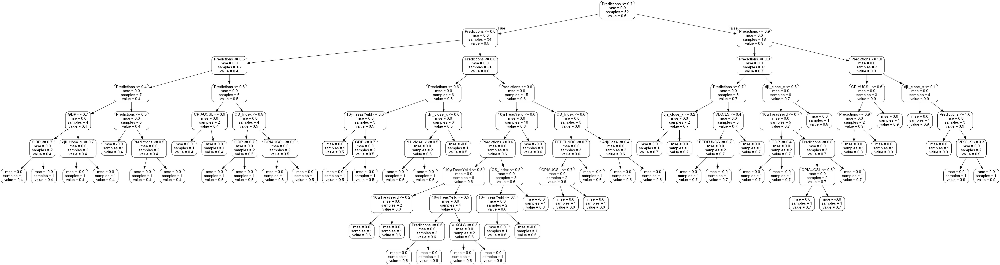

In [822]:
# View of Tree 
# Pull out one tree from the forest
tree = model_rf.estimators_[5]
# Export the image to a dot file
export_graphviz(tree, out_file = 'tree.dot', feature_names = predictorsND, rounded = True, precision = 1)
# Use dot file to create a graph
(graph, ) = pydot.graph_from_dot_file('tree.dot')
# Write graph to a png file
graph.write_png('tree.png')

#Show tree in notebook 
from IPython.display import Image 
Image(filename = 'tree.png', width = 1000, height = 600)

<AxesSubplot:>

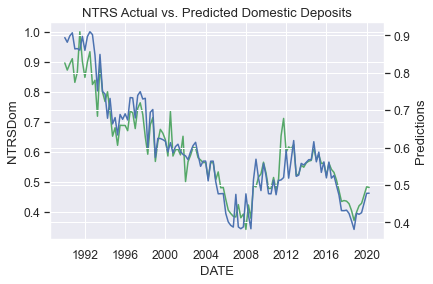

In [821]:
#Plot Predictions agains actuals: 
sns.set_style("darkgrid")
sns.lineplot(data = NTRSDom2, x='DATE', y='NTRSDom', color = 'g').set_title('NTRS Actual vs. Predicted Domestic Deposits')
ax2 = plt.twinx()
sns.lineplot(data = NTRSDom2, x = 'DATE', y = "Predictions", color = 'b')
ax

Getting a visual on our predictions in blue versus our actuals in green, the random forest model peforms quite effectively in predicting domestic deposit movements. 

### NTRS Foreign Office Deposits:

In [823]:
#Create arrays for features and response variables NTRNDom2
target_col_NF = ['NTRSFo']
predictorsNF = list(set(list(NTRSFo2.columns))-set(target_col_NF))
NTRSFo2[predictorsNF] = NTRSFo2[predictorsNF]/NTRSFo2[predictorsNF].max()
NTRSFo2.describe()

C:\Users\Cathy\anaconda3\lib\site-packages\pandas\core\frame.py:3065: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[k1] = value[k2]


,NTRSFo,VIXCLS,djii_close_x,10yrTreasYeild,AdjClose,GDP,CS_Index,FEDFUNDS,CPIAUCSL
count,121.000000,121.000000,121.000000,121.000000,121.000000,121.000000,121.000000,121.000000,121.000000
mean,2154.865620,0.330721,0.413270,0.497379,0.424960,0.637845,0.611513,0.342638,0.744428
std,948.725361,0.122931,0.226954,0.220384,0.227024,0.181524,0.197848,0.284318,0.144453
min,500.220000,0.175744,0.094714,0.076668,0.106933,0.347178,0.333075,0.007167,0.490946
25%,1303.860000,0.240361,0.277185,0.298551,0.277131,0.477108,0.394429,0.044955,0.622626
50%,2298.480000,0.301200,0.389478,0.483921,0.406903,0.649284,0.637437,0.283952,0.746752
75%,3031.180000,0.388747,0.491825,0.662850,0.495272,0.761942,0.777249,0.619066,0.871968
max,3594.880000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [824]:
#Create Testng and Training Sets NTRS Foreign Office Deposits 
X_NF = NTRSFo2[predictorsNF].values
y_NF = NTRSFo2[target_col_NF].values

X_NF_train, X_NF_test, y_NF_train, y_NF_test = train_test_split(X_NF, y_NF, test_size=0.30, random_state=40)
print(X_NF_train.shape); print(X_NF_test.shape)

(84, 8)
(37, 8)


In [825]:
#RF model
model_rf = RandomForestRegressor(n_estimators=500, oob_score=True, random_state=100)
model_rf.fit(X_NF_train, y_NF_train) 
pred_train_rf= model_rf.predict(X_NF_train)
print(np.sqrt(mean_squared_error(y_NF_train,pred_train_rf)))
print(r2_score(y_NF_train, pred_train_rf))

pred_test_rf = model_rf.predict(X_NF_test)
print(np.sqrt(mean_squared_error(y_NF_test,pred_test_rf)))
print(r2_score(y_NF_test, pred_test_rf))

<ipython-input-825-0d6cb9d5619b>:3: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  model_rf.fit(X_NF_train, y_NF_train)


59.558031807931705
0.9961309802362638
188.24353312979878
0.9574915640473138


Our random forest model and foreign office depoists are good friends! RMSE is good and high r-squared across both testing and training sets.  

In [826]:
#Getting a full array of predictions on our dataset 
y_NF_PredFull = model_rf.predict(X_NF)
y_NF_PredFull

array([ 560.86876,  650.899  ,  643.50008,  558.95962,  668.55114,
        736.38394,  766.74872,  581.272  ,  584.93264,  625.66074,
        716.91944,  783.06964,  867.65758,  917.35116,  912.571  ,
        993.10558, 1007.3051 , 1190.3597 , 1172.20848, 1186.73412,
       1344.54106, 1348.02268, 1365.40874, 1244.4248 , 1138.04826,
       1055.61322, 1166.56038, 1125.66748, 1157.9496 , 1212.0014 ,
       1216.56316, 1305.34316, 1358.69364, 1415.13772, 1471.39452,
       1457.57198, 1408.61002, 1445.37198, 1303.03506, 1299.88552,
       1306.8737 , 1376.13066, 1410.84544, 1676.82324, 1557.40386,
       1664.64906, 1541.42768, 1719.8671 , 1614.26438, 1724.92868,
       1719.0062 , 1740.12672, 1748.65196, 1839.04698, 2028.08972,
       2040.7715 , 2123.89268, 2082.33226, 2330.7721 , 2384.4906 ,
       2367.1935 , 2681.86614, 2673.19504, 2711.5423 , 2715.34198,
       3013.52568, 2960.215  , 3096.1636 , 3054.33028, 3150.21214,
       3275.10268, 3346.21592, 3289.21716, 3471.9627 , 3419.19

In [827]:
#Appending predictions to dataframe of NTRS Foreign Office Deposits 
NTRSFo2['Predictions'] = y_NF_PredFull
NTRSFo2.head()

<ipython-input-827-f6d0f8cb41da>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  NTRSFo2['Predictions'] = y_NF_PredFull


,NTRSFo,VIXCLS,djii_close_x,10yrTreasYeild,AdjClose,GDP,CS_Index,FEDFUNDS,CPIAUCSL,Predictions
DATE,,,,,,,,,,
1990-01-01,500.22,0.375600,0.098496,0.938393,0.112037,0.354466,0.350213,0.976112,0.490946,560.86876
1990-04-01,721.92,0.325381,0.104918,0.982461,0.118101,0.364252,0.358784,0.988093,0.503467,650.89900
1990-07-01,856.70,0.439722,0.104007,1.000000,0.115480,0.369976,0.364800,1.000000,0.511990,643.50008
1990-10-01,508.16,0.452282,0.094714,0.922376,0.106933,0.358563,0.359066,0.983899,0.504217,558.95962
1991-01-01,688.08,0.365601,0.099416,0.851937,0.113421,0.347178,0.333075,0.735140,0.501126,668.55114


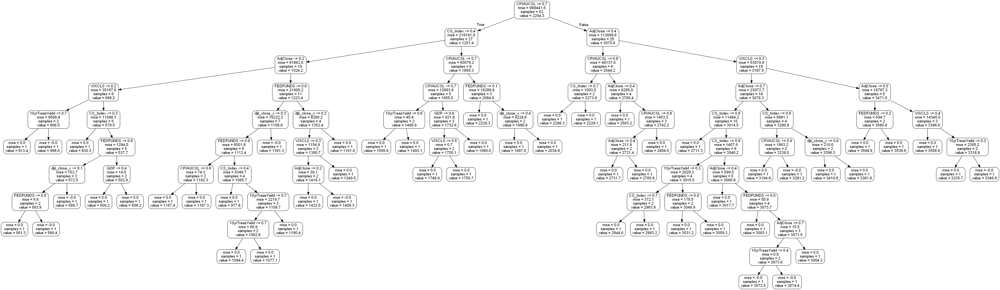

In [829]:
# View of Tree 
# Pull out one tree from the forest
tree = model_rf.estimators_[5]
# Export the image to a dot file
export_graphviz(tree, out_file = 'tree.dot', feature_names = predictorsNF, rounded = True, precision = 1)
# Use dot file to create a graph
(graph, ) = pydot.graph_from_dot_file('tree.dot')
# Write graph to a png file
graph.write_png('tree.png')

#Show tree in notebook 
from IPython.display import Image 
Image(filename = 'tree.png', width = 1000, height = 600)

<AxesSubplot:>

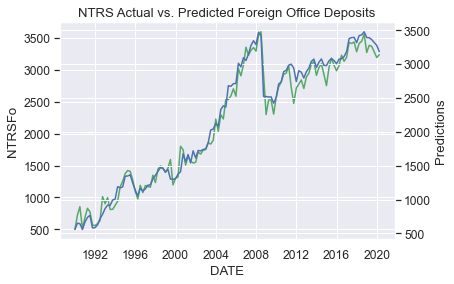

In [830]:
#Plot Predictions agains actuals: 
sns.set_style("darkgrid")
sns.lineplot(data = NTRSFo2, x='DATE', y='NTRSFo', color = 'g').set_title('NTRS Actual vs. Predicted Foreign Office Deposits')
ax2 = plt.twinx()
sns.lineplot(data = NTRSFo2, x = 'DATE', y = "Predictions", color = 'b')
ax

The results look amazing, proving that random forest regressors are an adequate methodology for forecasting foreign office deposits. It will be pretty cool to see this methodology applied to more granular data to get daily predictions.  Overall I'm very statisfied with this approach and look forward to helping apply the methodology for additional forecasting. 

Thanks! 

### References
[1] python-edgar. (2019, November 9). Retrieved from https://pypi.org/project/python-edgar/

[2] Schroeder, J. (2019, August 27). Tutorial: real-time live feed of SEC filings using Python & socket.io. Retrieved from https://medium.com/@jan_5421/crawling-new-filings-on-sec-edgar-using-python-and-socket-io-in-real-time-5cba8c6a3eb8

[3] Chen, K. (2020). Use Python to download TXT-format SEC filings on EDGAR (Part I) | Kai Chen. Retrieved October 29, 2020, from http://kaichen.work/?p=59

[4] A. (2020). amaline/fdic-banks-api-python-client. Retrieved from https://github.com/amaline/fdic-banks-api-python-client

[5] D. (2020b). dpguthrie/bankfind. Retrieved from https://github.com/dpguthrie/bankfind

[6] Federal Reserve Economic Data | FRED | St. Louis Fed. (2020). Retrieved from https://fred.stlouisfed.org/

[7]Yahoo is now a part of Verizon Media. (2020). Retrieved from https://finance.yahoo.com/quote/%5EGSPC/history/

[8]Sarkar, T. (2018, November 5). What if your data is NOT Normal? - Towards Data Science. Medium. https://towardsdatascience.com/what-if-your-data-is-not-normal-d7293f7b8f0

[9] Chaipitakporn, C. (2019, October 26). Illustration with Python: Chebyshev’s Inequality - Analytics Vidhya. Medium. https://medium.com/analytics-vidhya/illustration-with-python-chebyshevs-inequality-b34be151c547

[10] Brownlee, J. (2020, August 28). How to Develop a Framework to Spot-Check Machine Learning Algorithms in Python. Machine Learning Mastery. https://machinelearningmastery.com/spot-check-machine-learning-algorithms-in-python/

[11] Singh, D. (2019, May 21). Non-Linear Regression Trees with scikit-learn. Pluralsight. https://www.pluralsight.com/guides/non-linear-regression-trees-scikit-learn

[12]Brownlee, J. (2020a, August 20). How to Calculate Feature Importance With Python. Machine Learning Mastery. https://machinelearningmastery.com/calculate-feature-importance-with-python/